# Analyse the Extracted Samples

In [1]:
# import necessary modules

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import pickle
import warnings
import tqdm
import pandas as pd
import librosa
import librosa.display as display
import biosppy
from scipy import signal
from scipy.stats import zscore
from scipy.io import wavfile
from scipy.fft import fft,fftfreq
from scipy.fftpack import fft

warnings.filterwarnings("ignore")

%matplotlib inline
import matplotlib as mlp
mlp.rc("xtick",labelsize=10)
mlp.rc("ytick",labelsize=10)
mlp.rc("axes",labelsize=11)
plt.rcParams["figure.figsize"] = [11,5]
plt.rcParams["figure.dpi"] = 300

CURR_DIR = os.getcwd()

In [2]:
# make necessary definitions

# directories definitions
MAIN_DIR = "."
if os.path.basename(os.getcwd())!="Silent-Interface-for-IOT-Devices":
    os.chdir("..")

DATA_DIR = os.path.join(MAIN_DIR,"dataset")
FIG_DIR = os.path.join(MAIN_DIR,"figures")
PICKLE_DIR = os.path.join(MAIN_DIR,"pickles")
os.makedirs(FIG_DIR,exist_ok=True)
os.makedirs(PICKLE_DIR,exist_ok=True)

# hardware definitions
"""
https://docs.openbci.com/docs/02Cyton/CytonDataFormat#:~:text=By%20default%2C%20our%20Arduino%20sketch,of%200.02235%20microVolts%20per%20count
"""
SAMPLING_RATE = 250 #Hz
NUM_CHANNELS = 8 
ADC_RESOLUTION = 24 #bits
ADC_GAIN = 24.0
REF_VOLTAGE = 4.5 #Volts
SCALE_FACTOR = (REF_VOLTAGE/float((pow(2,23))-1)/ADC_GAIN)*1000000.0 #micro-volts

# dataset definitions
SPEAKER = ["RL","RN","SR","US"]
SESSION = ["session1","session2","session3"]
MODE = ["mentally","mouthed","audible"]
SENTENCES =["अबको समय सुनाउ","एउटा सङ्गित बजाउ","आजको मौसम बताउ","बत्तिको अवस्था बदल","पङ्खाको स्तिथी बदल"]
WORDS = ["समय","सङ्गित","मौसम","बत्ति","पङ्खा"]

SENTENCE_LABEL= np.array(SENTENCES)[[0,1,2,0,3,1,0,3,0,0,1,1,3,3,4,4,2,3,1,2,2,2,4,4,4]]
WORD_LABEL= np.array(WORDS)[[4,0,3,1,0,1,1,0,4,0,3,2,4,4,2,1,4,1,2,2,2,0,3,3,3]]

LABELS = {"word":WORD_LABEL,"sentence":SENTENCE_LABEL}

# a function to save plotted figures
def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(FIG_DIR, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)
    

In [3]:
all_files = glob.glob(DATA_DIR+"/*/*/*/*/*.txt",recursive=True)
print(len(all_files))

159


In [4]:
def parser(files,FILTER=True):
    """
    parser function to extract utterances from .txt file and store them in a dictionary
    """
    
    dataset = {"data":[], "speaker":[], "mode":[], "utter_type":[], "labels":[], "session":[], "filename":[]}
    def get_data(file):
        session = file.split("/")[-4]
        mode = file.split("/")[-2]
        speaker = file.split("/")[-5]
        utter_type = file.split("/")[-3]
        filename = file.split("/")[-1]
        
        signal = read_data(file)
        
        # only take files with 25 labels         
        if (len(signal)!=25 and FILTER):
            return
        
        dataset["data"].extend(signal)
        dataset["speaker"].extend([speaker]*len(signal))
        dataset["mode"].extend([mode]*len(signal))
        dataset["session"].extend([session]*len(signal))
        dataset["utter_type"].extend([utter_type]*len(signal))
        dataset["labels"].extend(LABELS[utter_type])
        dataset["filename"].extend([filename]*len(signal))
        
    
    def read_data(file):
        f = open(file, 'r')
        contents = map(lambda x : x.strip(), f.readlines())
        #the file starts with '%' and some instruction before data and removing these data 
        frames_original = list(filter(lambda x : x and x[0] != '%', contents))[1:]
        #the data row contains channels info digital trigger and accelerometer info separated by comma
        frames_original = list(map(lambda s : list(map( lambda ss: ss.strip(), s.split(','))), frames_original))
        # (8 channels) + digital triggers
        # the digital trigger is in a[16], used to indicate the utterance
        frames = list(map(lambda a: list(map(float, a[1:9])) + [float(a[16])] , frames_original))
        frames = np.array(frames)
        indices = []
        signal = []
        for index,f in enumerate(frames[:,-1]):
            if(bool(f) ^ bool(frames[(index+1) if ((index+1)<len(frames)) else index,-1]) ):
                indices.append(index)
                if len(indices)>1 and len(indices)%2==0:
                    signal.append(frames[indices[len(indices)-2]:indices[len(indices)-1],:-1])   
        
        # convert to microVolts and return
        return np.array(signal)*SCALE_FACTOR
        
    for file,i in zip(files,tqdm.tqdm(range(1,len(files)+1),desc="PARSING DATA")):
        get_data(file)
    
    return dataset

In [5]:
if "data_dict.pickle" in os.listdir(PICKLE_DIR):
    #TODO : implement MLTD here
    all_data = pickle.load(open(os.path.join(PICKLE_DIR,"data_dict.pickle"),"rb"))
else:
    all_data = parser(all_files)
    pickle.dump(all_data,open(os.path.join(PICKLE_DIR,"data_dict.pickle"),"wb"))

In [6]:
print(type(all_data))
print(all_data.keys())
print(len(all_data["data"]))
# print(len(all_data["speaker"]))
# print(len(all_data["mode"]))
# print(len(all_data["utter_type"]))
# print(len(all_data["labels"]))
# print(len(all_data["session"]))
# print(len(all_data["filename"]))

<class 'dict'>
dict_keys(['data', 'speaker', 'mode', 'utter_type', 'labels', 'session', 'filename'])
3225


In [7]:
df = pd.DataFrame(all_data)

In [8]:
df.head(5)

,data,speaker,mode,utter_type,labels,session,filename
0,"[[-530.9783497035771, 155.7424479083003, 41.75...",US,mentally,word,पङ्खा,session2,OpenBCI-RAW-2021-05-14_11-13-41.txt
1,"[[-530.7855222518992, 157.93270058616594, 46.2...",US,mentally,word,समय,session2,OpenBCI-RAW-2021-05-14_11-13-41.txt
2,"[[-529.3366751913861, 160.8628527579784, 49.23...",US,mentally,word,बत्ति,session2,OpenBCI-RAW-2021-05-14_11-13-41.txt
3,"[[-531.4724891478928, 151.53431728495528, 38.6...",US,mentally,word,सङ्गित,session2,OpenBCI-RAW-2021-05-14_11-13-41.txt
4,"[[-527.5236518569546, 157.46656630604573, 45.3...",US,mentally,word,समय,session2,OpenBCI-RAW-2021-05-14_11-13-41.txt


In [9]:
df.tail(5)

,data,speaker,mode,utter_type,labels,session,filename
3220,"[[-4.312551086745494, -231.87156183836976, -37...",RL,audible,sentence,आजको मौसम बताउ,session3,OpenBCI-RAW-2021-05-15_16-23-31.txt
3221,"[[-4.887091804958707, -229.7152951625714, -33....",RL,audible,sentence,आजको मौसम बताउ,session3,OpenBCI-RAW-2021-05-15_16-23-31.txt
3222,"[[-7.0773400490371525, -234.62386048105932, -4...",RL,audible,sentence,पङ्खाको स्तिथी बदल,session3,OpenBCI-RAW-2021-05-15_16-23-31.txt
3223,"[[-9.815650434172252, -233.74157775558714, -32...",RL,audible,sentence,पङ्खाको स्तिथी बदल,session3,OpenBCI-RAW-2021-05-15_16-23-31.txt
3224,"[[-11.068148933849823, -244.76775441344137, -4...",RL,audible,sentence,पङ्खाको स्तिथी बदल,session3,OpenBCI-RAW-2021-05-15_16-23-31.txt


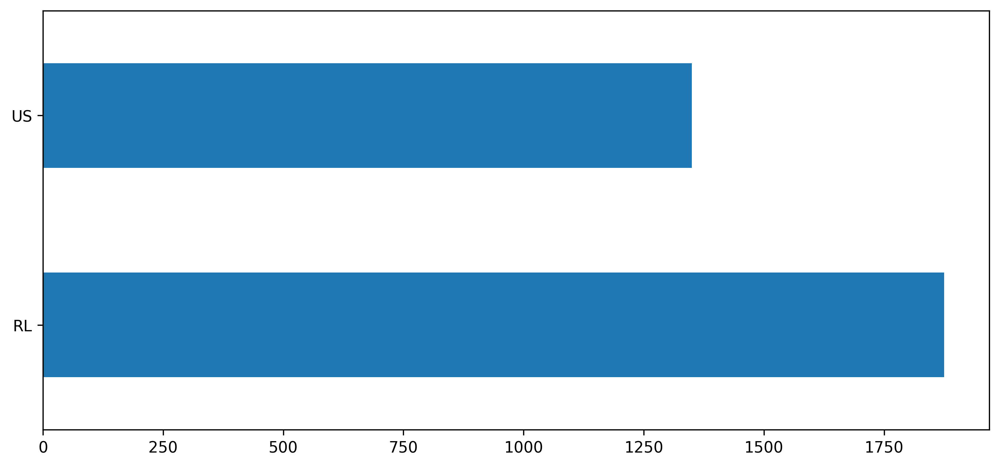

In [10]:
df["speaker"].value_counts().plot.barh()
plt.show()

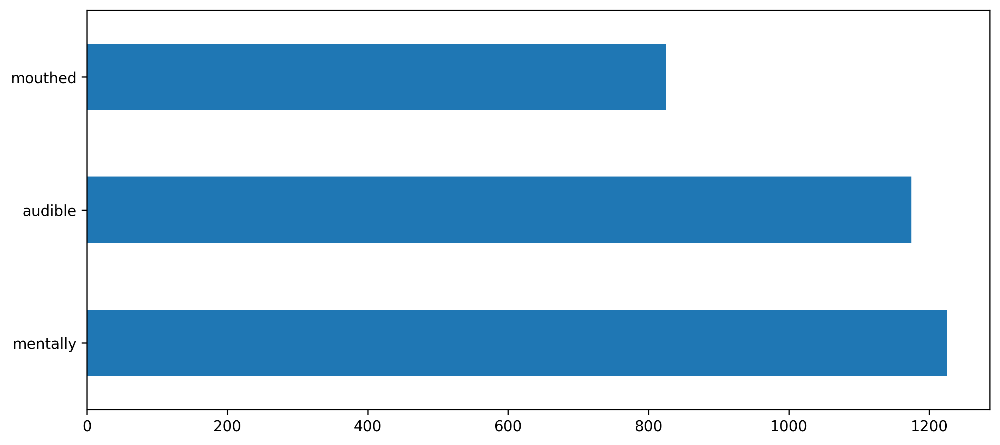

In [11]:
df["mode"].value_counts().plot.barh()
plt.show()

## ANALYSE LENGTH OF SAMPLES

In [12]:
all_words = df[df["utter_type"]=="word"]
all_sentences = df[df["utter_type"]=="sentence"]
all_word_length = [x.shape[0]/SAMPLING_RATE for x in all_words["data"]]
all_sent_length = [x.shape[0]/SAMPLING_RATE for x in all_sentences["data"]]

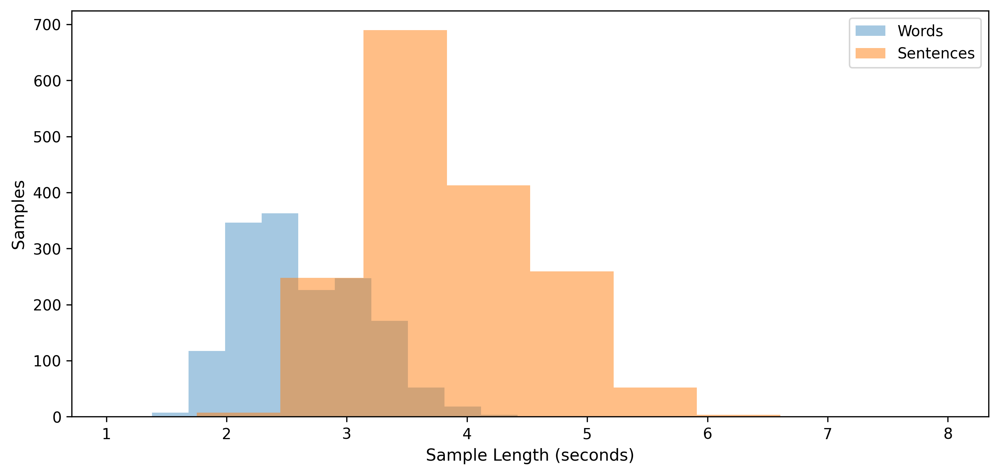

In [13]:
plt.hist(all_word_length,alpha=0.4)
plt.hist(all_sent_length,alpha=0.5)
plt.xlabel("Sample Length (seconds)")
plt.ylabel("Samples")
plt.legend(["Words","Sentences"])
# save_fig("length distribution")
plt.show()

In [14]:
print("Max length of words utterances in seconds: %.2fs" % np.max(all_word_length))
print("Min length of words utterances in seconds: %.2fs" % np.min(all_word_length))
print("Avg length of words utterances in seconds: %.2fs" % np.mean(all_word_length))
print("\n")
print("Max length of sentence utterances in seconds: %.2fs" % np.max(all_sent_length))
print("Min length of sentence utterances in seconds: %.2fs" % np.min(all_sent_length))
print("Avg length of sentence utterances in seconds: %.2fs" % np.mean(all_sent_length))

Max length of words utterances in seconds: 4.42s
Min length of words utterances in seconds: 1.38s
Avg length of words utterances in seconds: 2.63s


Max length of sentence utterances in seconds: 7.99s
Min length of sentence utterances in seconds: 1.06s
Avg length of sentence utterances in seconds: 3.84s


In [15]:
all_words_RL = df.query('utter_type=="word" and speaker=="RL"')
all_words_US = df.query('utter_type=="word" and speaker=="US"')

all_sent_RL = df.query('utter_type=="sentence" and speaker=="RL"')
all_sent_US = df.query('utter_type=="sentence" and speaker=="US"')


all_word_length_RL = [x.shape[0]/SAMPLING_RATE for x in all_words_RL["data"]]
all_sent_length_RL = [x.shape[0]/SAMPLING_RATE for x in all_sent_RL["data"]]

all_word_length_US = [x.shape[0]/SAMPLING_RATE for x in all_words_US["data"]]
all_sent_length_US = [x.shape[0]/SAMPLING_RATE for x in all_sent_US["data"]]


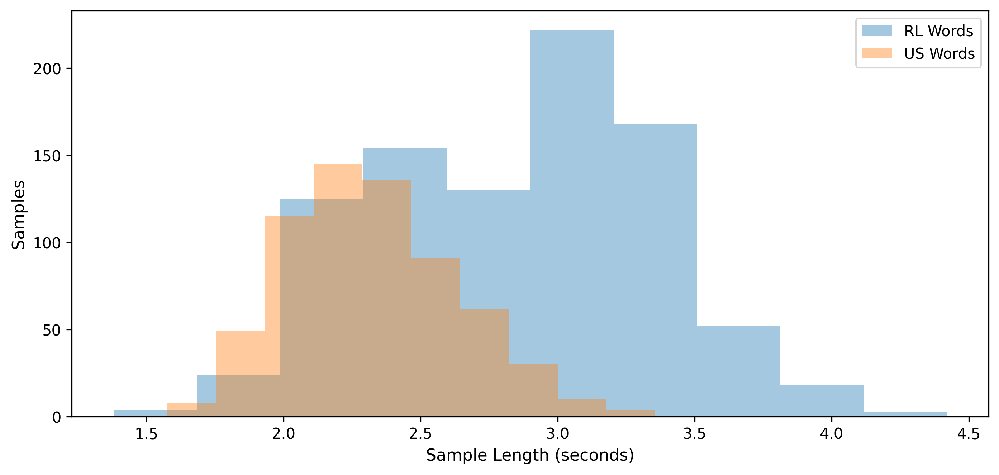

In [16]:
plt.hist(all_word_length_RL,alpha=0.4)
plt.hist(all_word_length_US,alpha=0.4)
plt.xlabel("Sample Length (seconds)")
plt.ylabel("Samples")
# save_fig("length distribution")
plt.legend(["RL Words","US Words"])
plt.show()

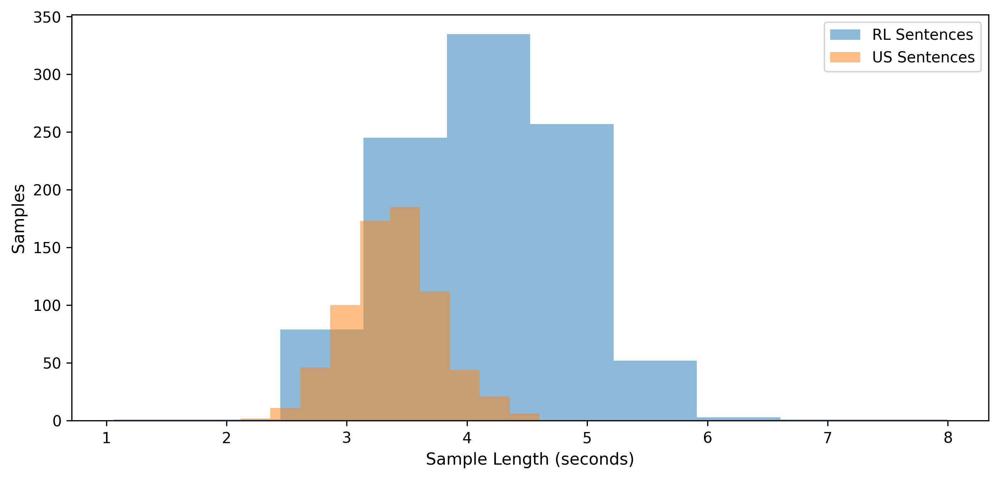

In [17]:
plt.hist(all_sent_length_RL,alpha=0.5)
plt.hist(all_sent_length_US,alpha=0.5)
plt.xlabel("Sample Length (seconds)")
plt.ylabel("Samples")
# save_fig("length distribution")
plt.legend(["RL Sentences","US Sentences"])
plt.show()

In [18]:
# SENTENCES =["अबको समय सुनाउ","एउटा सङ्गित बजाउ","आजको मौसम बताउ","बत्तिको अवस्था बदल","पङ्खाको स्तिथी बदल"]
# WORDS = ["समय","सङ्गित","मौसम","बत्ति","पङ्खा"]

all_words_RL = df.query('utter_type=="word" and speaker=="RL" and labels=="मौसम"')
all_words_US = df.query('utter_type=="word" and speaker=="US" and labels=="मौसम"')

all_sent_RL = df.query('utter_type=="sentence" and speaker=="RL" and labels=="आजको मौसम बताउ"')
all_sent_US = df.query('utter_type=="sentence" and speaker=="US" and labels=="आजको मौसम बताउ"')


all_word_length_RL = [x.shape[0]/SAMPLING_RATE for x in all_words_RL["data"]]
all_sent_length_RL = [x.shape[0]/SAMPLING_RATE for x in all_sent_RL["data"]]

all_word_length_US = [x.shape[0]/SAMPLING_RATE for x in all_words_US["data"]]
all_sent_length_US = [x.shape[0]/SAMPLING_RATE for x in all_sent_US["data"]]


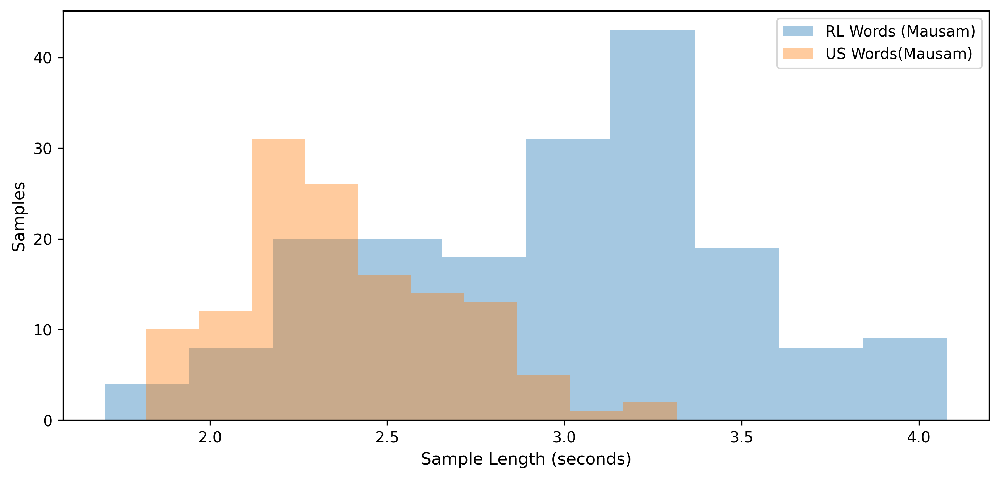

In [19]:
plt.hist(all_word_length_RL,alpha=0.4)
plt.hist(all_word_length_US,alpha=0.4)
plt.xlabel("Sample Length (seconds)")
plt.ylabel("Samples")
# save_fig("length distribution")
plt.legend(["RL Words (Mausam)","US Words(Mausam)"])
plt.show()

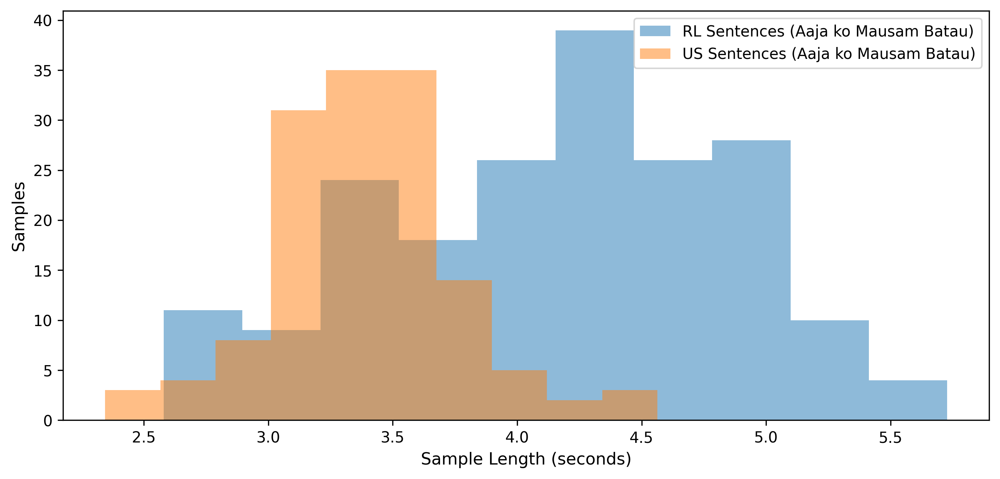

In [20]:
plt.hist(all_sent_length_RL,alpha=0.5)
plt.hist(all_sent_length_US,alpha=0.5)
plt.xlabel("Sample Length (seconds)")
plt.ylabel("Samples")
# save_fig("length distribution")
plt.legend(["RL Sentences (Aaja ko Mausam Batau)","US Sentences (Aaja ko Mausam Batau)"])
plt.show()

## SIGNAL ANALYSIS (RAW)

In [21]:
xxx = 1
sample_RL_audible = df.query('utter_type=="sentence" and mode=="audible" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
sample_RL_mouthed = df.query('utter_type=="sentence" and mode=="mouthed" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
sample_RL_mentally = df.query('utter_type=="sentence" and mode=="mentally" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]

sample_US_audible = df.query('utter_type=="sentence" and mode=="audible" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
sample_US_mouthed = df.query('utter_type=="sentence" and mode=="mouthed" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
sample_US_mentally = df.query('utter_type=="sentence" and mode=="mentally" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]


In [22]:
print("Length of RL samples in seconds (audible) : %.2f s" % (len(sample_RL_audible)/SAMPLING_RATE))
print("Length of US samples in seconds (audible) : %.2f s \n" % (len(sample_US_audible)/SAMPLING_RATE))

print("Length of RL samples in seconds (mouthed) : %.2f s" % (len(sample_RL_mouthed)/SAMPLING_RATE))
print("Length of US samples in seconds (mouthed) : %.2f s\n" % (len(sample_US_mouthed)/SAMPLING_RATE))

print("Length of RL samples in seconds (mentally) : %.2f s" % (len(sample_RL_mentally)/SAMPLING_RATE))
print("Length of US samples in seconds (mentally) : %.2f s" % (len(sample_US_mentally)/SAMPLING_RATE))

Length of RL samples in seconds (audible) : 4.08 s
Length of US samples in seconds (audible) : 3.60 s 

Length of RL samples in seconds (mouthed) : 4.98 s
Length of US samples in seconds (mouthed) : 3.50 s

Length of RL samples in seconds (mentally) : 5.25 s
Length of US samples in seconds (mentally) : 3.57 s


### TIME SERIES PLOT -AUDIBLE

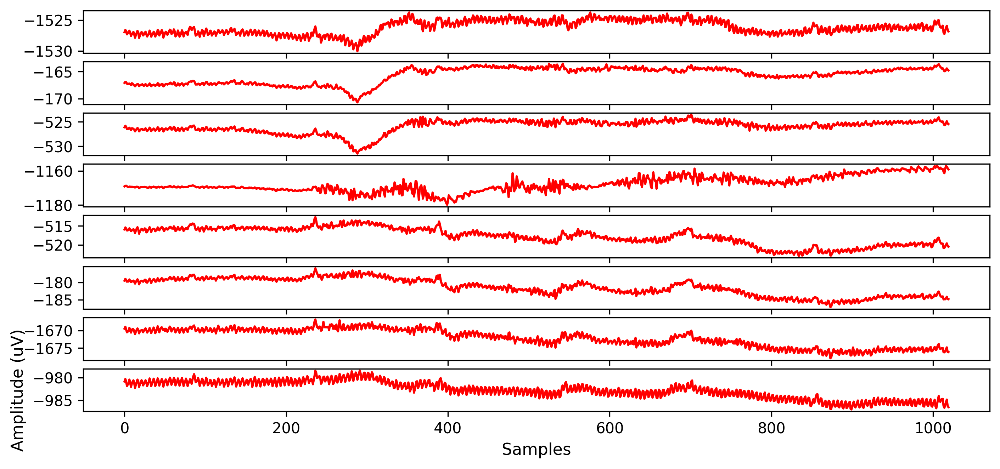

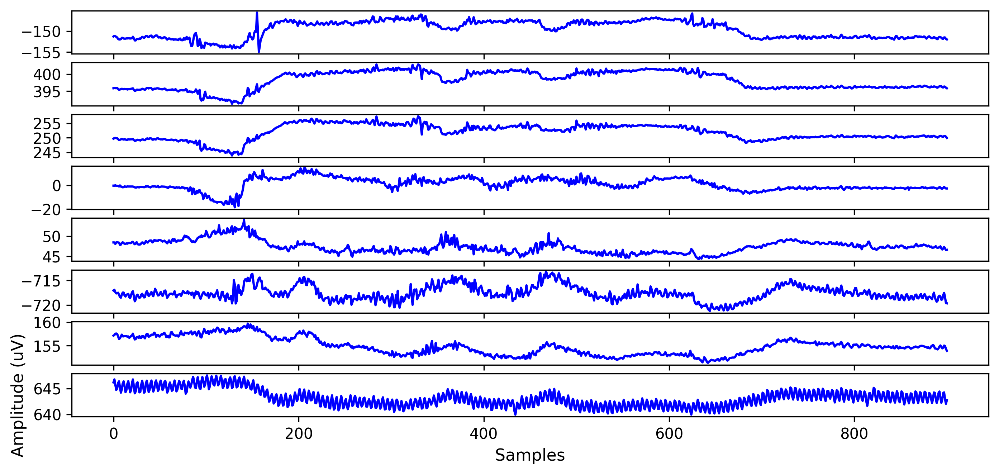

In [23]:
fig, axes = plt.subplots(nrows=8,ncols=1)
for i in range(8):
    axes[i].plot(sample_RL_audible[:,i],"r")

plt.xlabel("Samples")
plt.ylabel("Amplitude (uV)")
plt.show()


fig, axes = plt.subplots(nrows=8,ncols=1)
for i in range(8):
    axes[i].plot(sample_US_audible[:,i],"b")

plt.xlabel("Samples")
plt.ylabel("Amplitude (uV)")
plt.show()

### TIME SERIES PLOT -MOUTHED

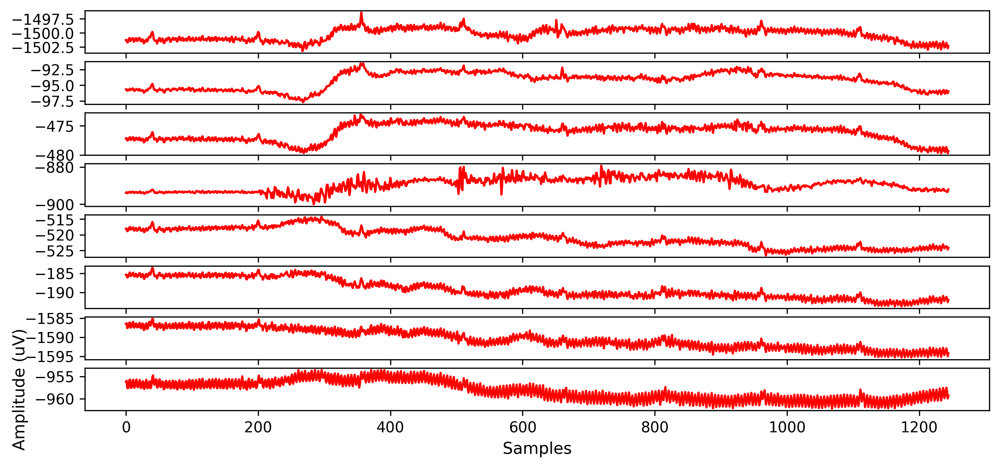

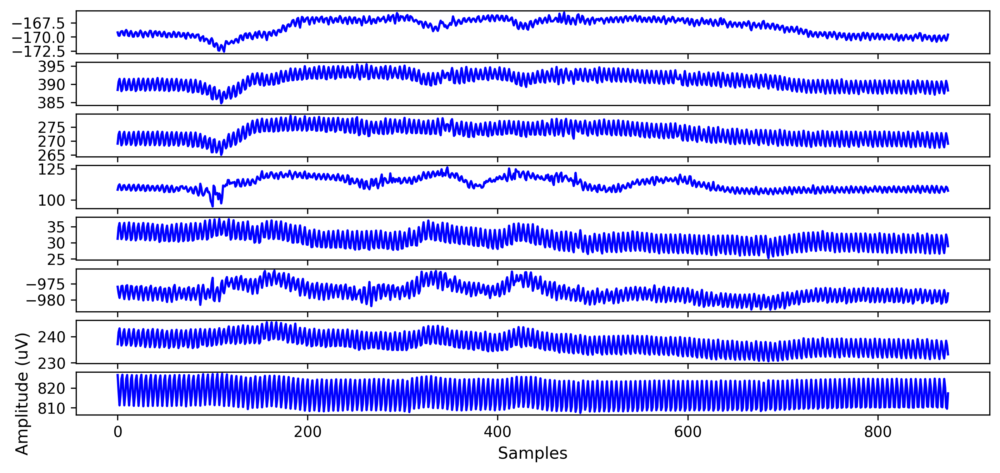

In [24]:
fig, axes = plt.subplots(nrows=8,ncols=1)
for i in range(8):
    axes[i].plot(sample_RL_mouthed[:,i],"r")

plt.xlabel("Samples")
plt.ylabel("Amplitude (uV)")
plt.show()

fig, axes = plt.subplots(nrows=8,ncols=1)
for i in range(8):
    axes[i].plot(sample_US_mouthed[:,i],"b")

plt.xlabel("Samples")
plt.ylabel("Amplitude (uV)")
plt.show()

### TIME SERIES PLOT -MENTALLY

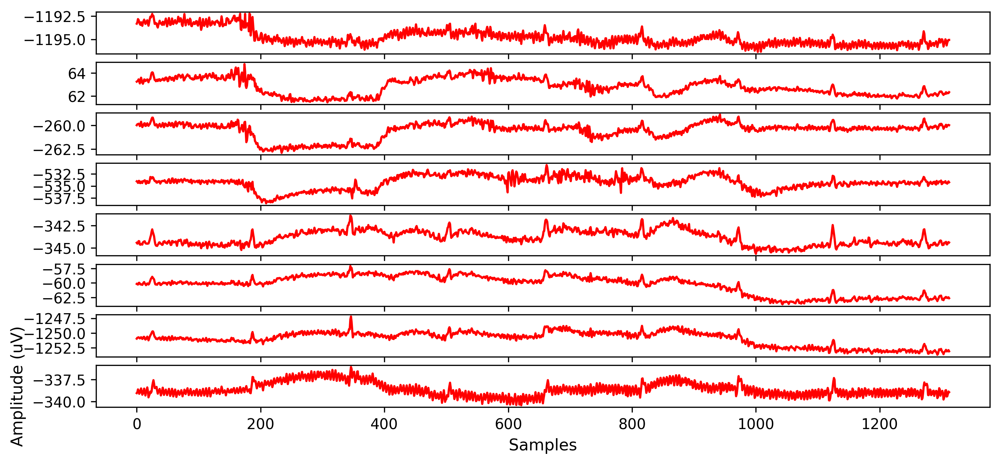

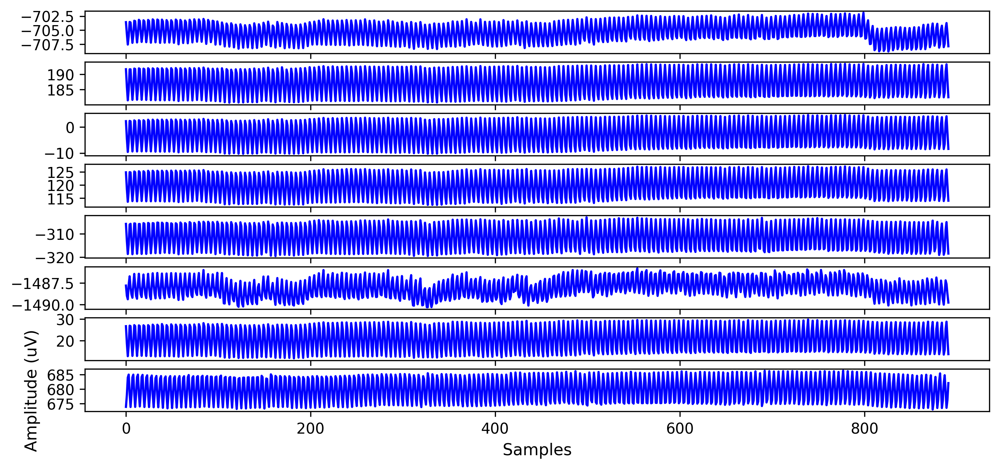

In [25]:
fig, axes = plt.subplots(nrows=8,ncols=1)
for i in range(8):
    axes[i].plot(sample_RL_mentally[:,i],"r")

plt.xlabel("Samples")
plt.ylabel("Amplitude (uV)")
plt.show()

fig, axes = plt.subplots(nrows=8,ncols=1)
for i in range(8):
    axes[i].plot(sample_US_mentally[:,i],"b")

plt.xlabel("Samples")
plt.ylabel("Amplitude (uV)")
plt.show()

### FFT

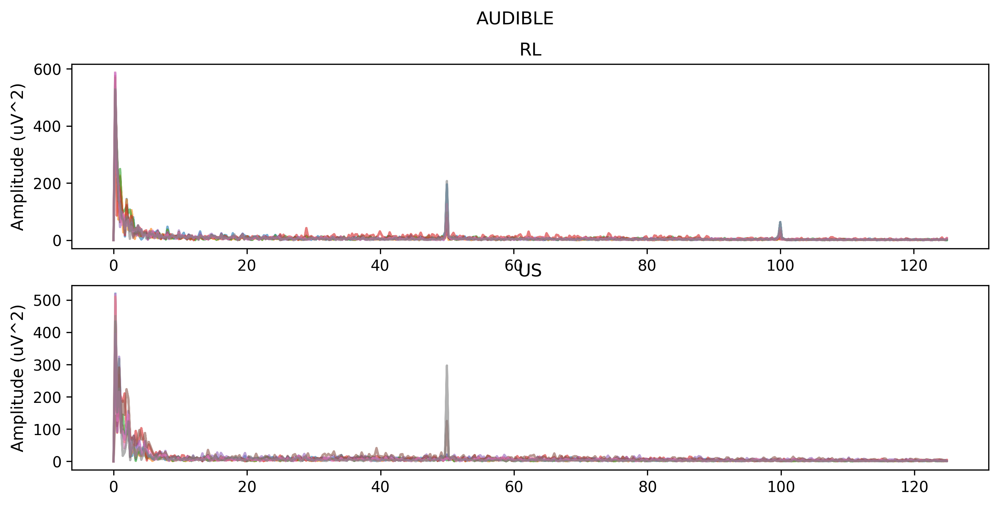

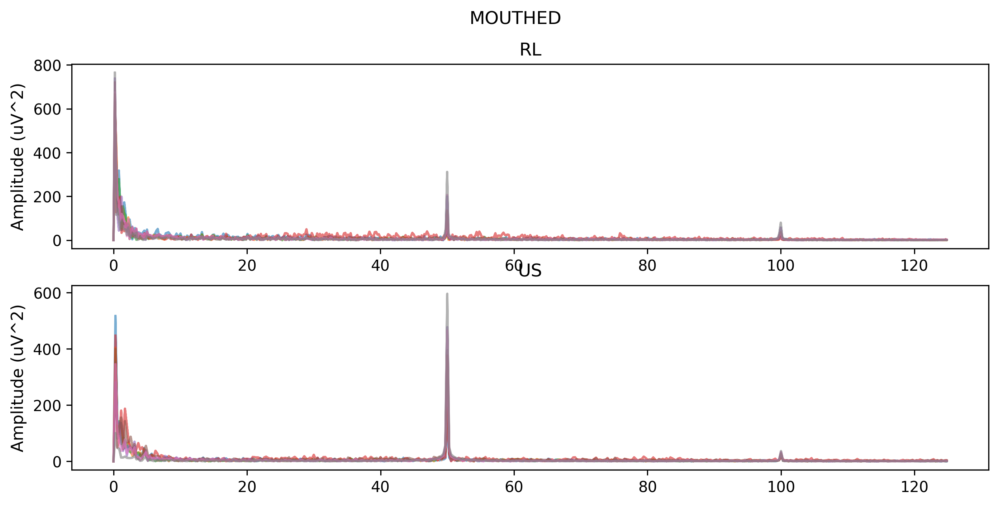

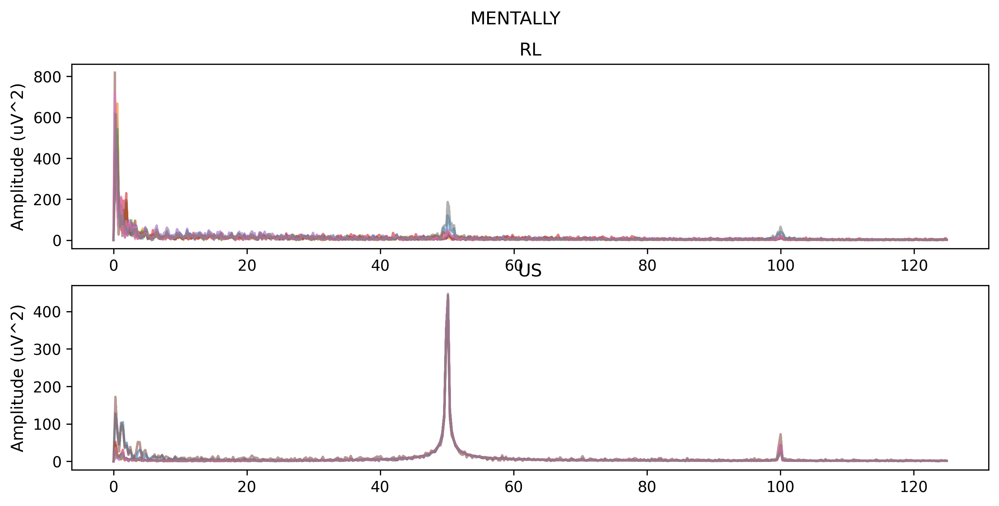

In [26]:
def FFT(data1, data2, MODE):
    plt.suptitle(MODE)
    plt.subplot(211).set_title("RL")
    N = len(data1)
    for i in range(NUM_CHANNELS):
        y = fft(zscore(data1[:,i]))
        x = fftfreq(N,1/SAMPLING_RATE)
        plt.plot(abs(x),abs(y),alpha=0.6)

    plt.ylabel("Amplitude (uV^2)")

    plt.subplot(212).set_title("US")
    N = len(data2)
    for i in range(NUM_CHANNELS):
        y = fft(zscore(data2[:,i]))
        x = fftfreq(N,1/SAMPLING_RATE)
        plt.plot(abs(x),abs(y),alpha=0.6)

    plt.ylabel("Amplitude (uV^2)")
    plt.title("US")
    plt.show()

FFT(data1=sample_RL_audible,data2=sample_US_audible,MODE="AUDIBLE")
FFT(data1=sample_RL_mouthed,data2=sample_US_mouthed,MODE="MOUTHED")
FFT(data1=sample_RL_mentally,data2=sample_US_mentally,MODE="MENTALLY")

### POWER SPECTRUM

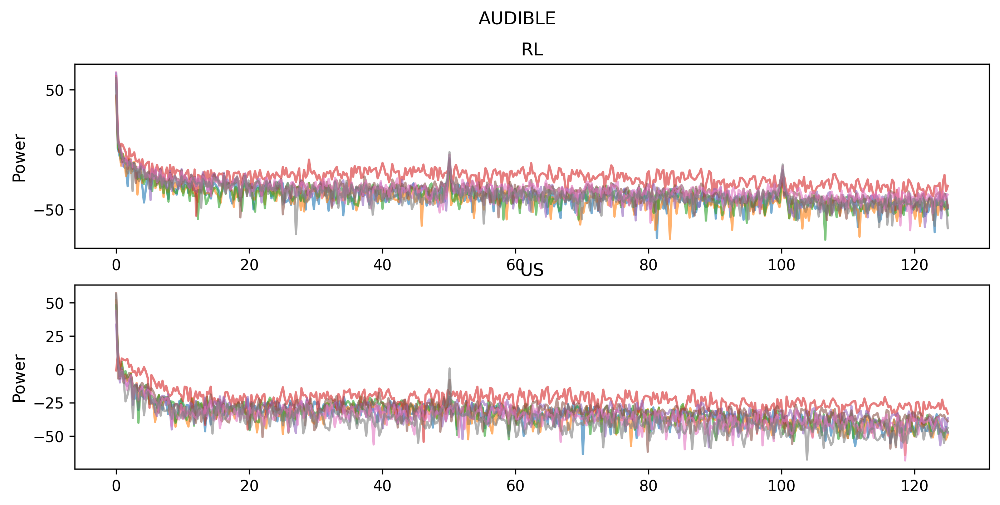

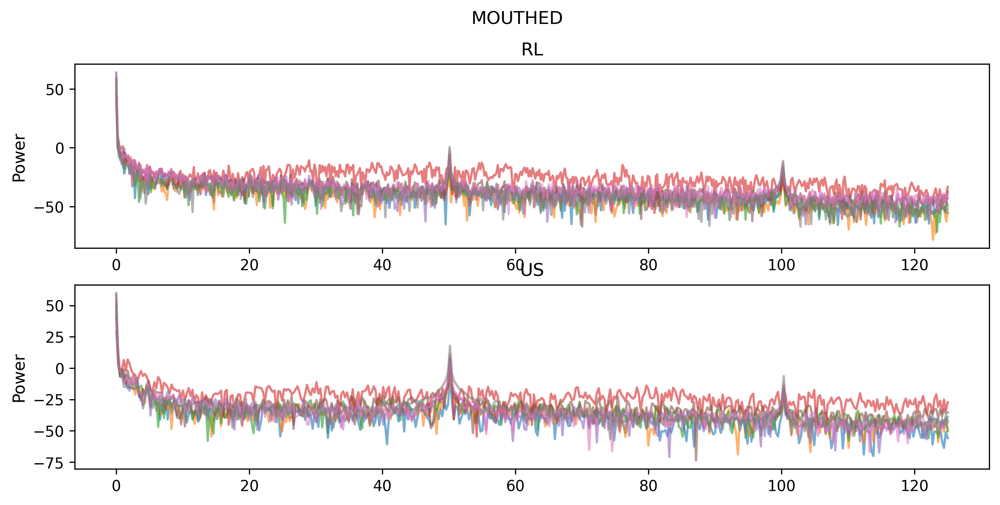

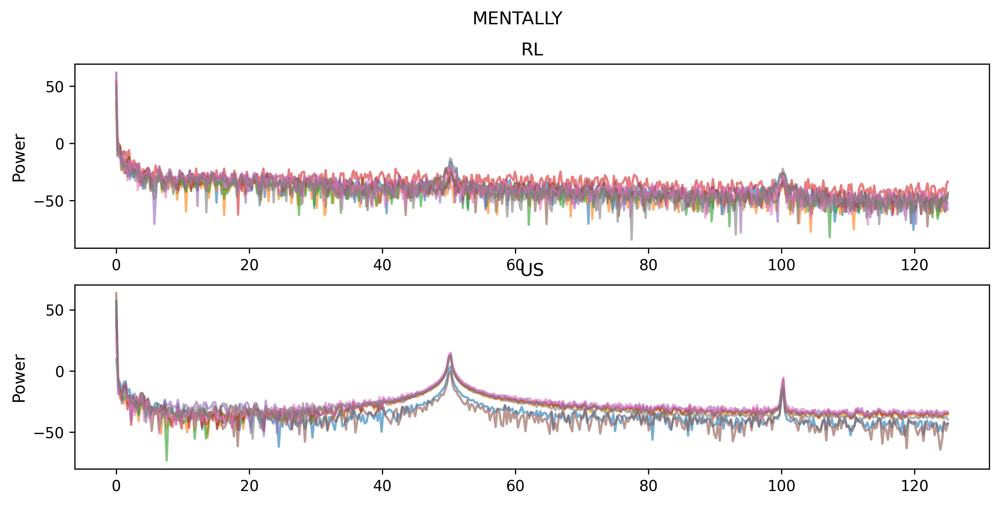

In [27]:
def power_spec(data1,data2,MODE):
    plt.suptitle(MODE)
    plt.subplot(211).set_title("RL")
    for i in range(NUM_CHANNELS):
        power = biosppy.signals.tools.power_spectrum(data1[:,i],sampling_rate=SAMPLING_RATE)
        plt.plot(power[0],power[1],alpha=0.6)
    plt.ylabel("Power")

    plt.subplot(212).set_title("US")
    for i in range(NUM_CHANNELS):
        power = biosppy.signals.tools.power_spectrum(data2[:,i],sampling_rate=SAMPLING_RATE)
        plt.plot(power[0],power[1],alpha=0.6)
    plt.ylabel("Power")
    plt.title("US")
    plt.show()

power_spec(data1=sample_RL_audible,data2=sample_US_audible,MODE="AUDIBLE")
power_spec(data1=sample_RL_mouthed,data2=sample_US_mouthed,MODE="MOUTHED")
power_spec(data1=sample_RL_mentally,data2=sample_US_mentally,MODE="MENTALLY")

### STFT

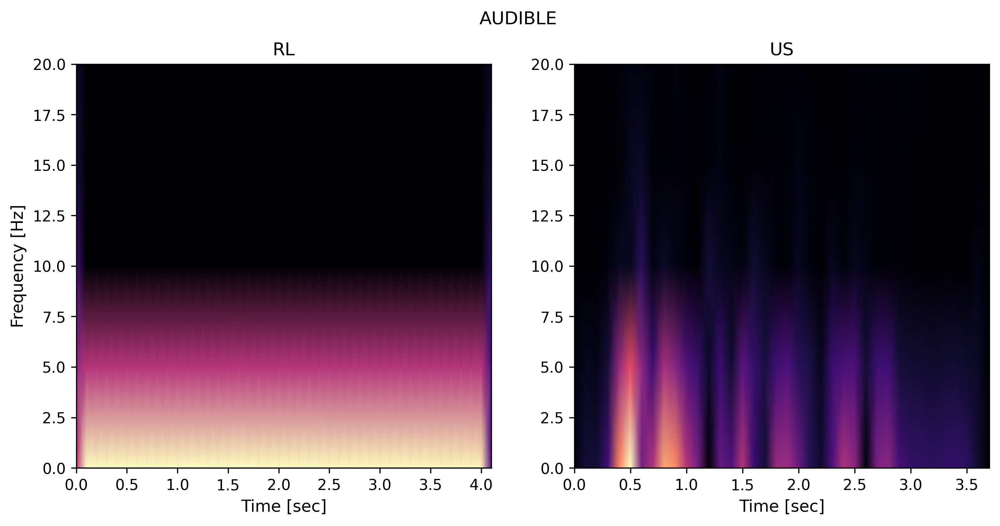

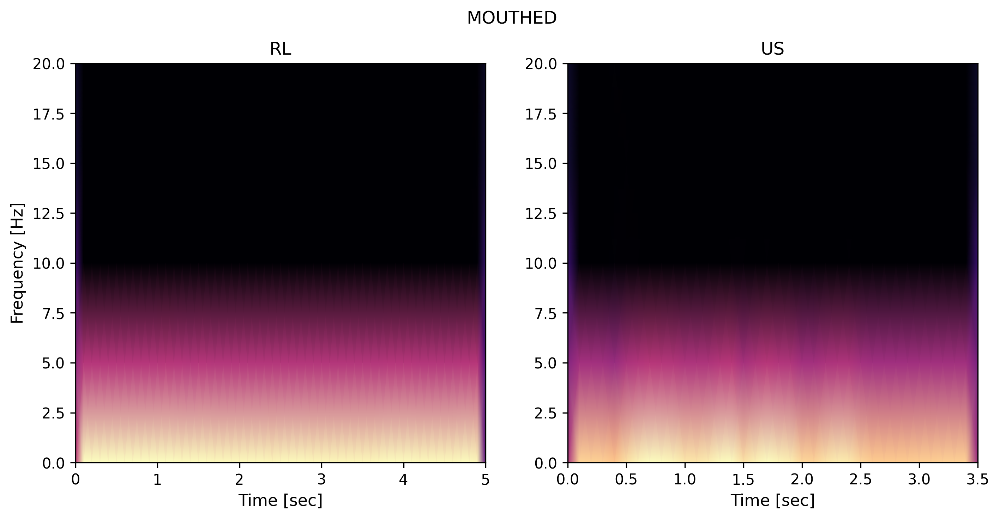

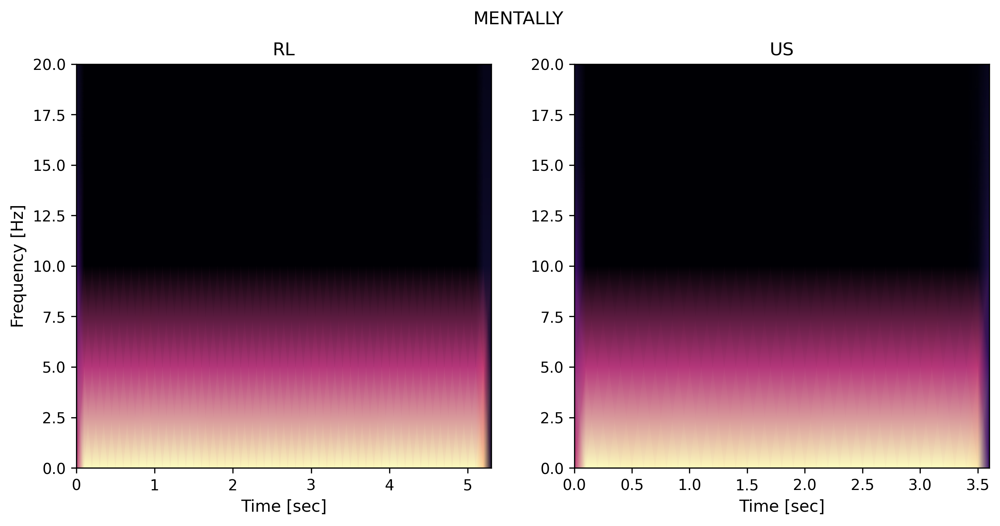

In [28]:
def STFT(data1,data2,MODE,channel=3):
    plt.suptitle(MODE)
    plt.subplot(121).set_title("RL")
    f, t, Zxx = signal.stft(data1[:,channel], fs=SAMPLING_RATE, nperseg=50)
    plt.pcolormesh(t, f, np.abs(Zxx), shading='gouraud',cmap="magma")
#     plt.colorbar()
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.ylim([0,20])
    
    plt.subplot(122).set_title("US")
    f, t, Zxx = signal.stft(data2[:,channel], fs=SAMPLING_RATE, nperseg=50)
    plt.pcolormesh(t, f, np.abs(Zxx), shading='gouraud',cmap="magma")
#     plt.colorbar()
#     plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.ylim([0,20])
    plt.show()

STFT(data1=sample_RL_audible,data2=sample_US_audible,MODE="AUDIBLE")
STFT(data1=sample_RL_mouthed,data2=sample_US_mouthed,MODE="MOUTHED")
STFT(data1=sample_RL_mentally,data2=sample_US_mentally,MODE="MENTALLY")

### SPECTOGRAM

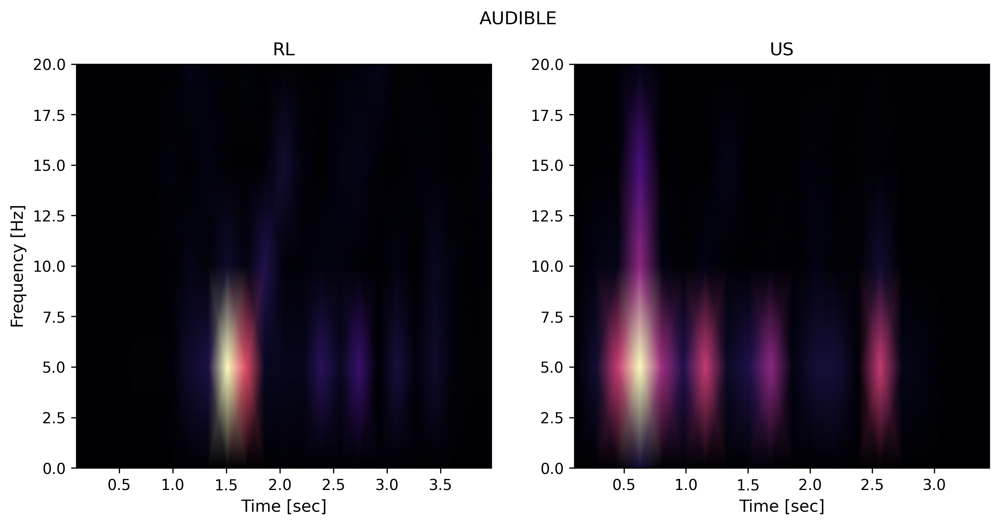

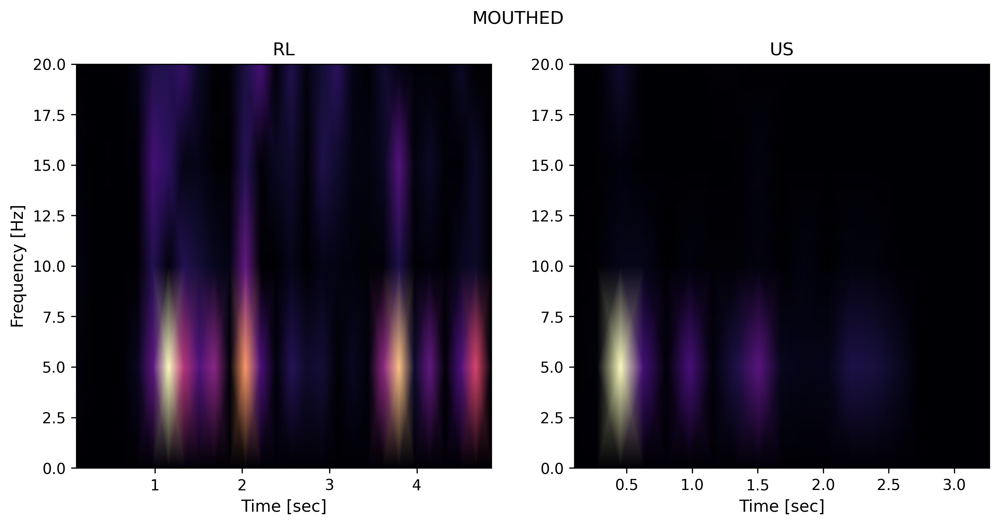

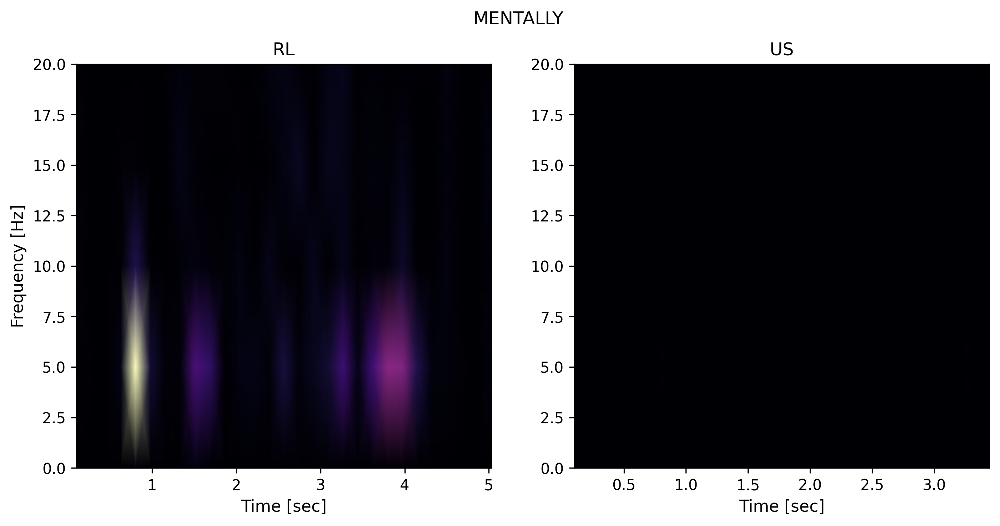

In [29]:
def SPECTOGRAM(data1,data2,MODE,channel=3):
    plt.suptitle(MODE)
    plt.subplot(121).set_title("RL")
    f, t, Sxx = signal.spectrogram(data1[:,channel], fs=SAMPLING_RATE,nperseg=50)
    plt.pcolormesh(t, f, Sxx, shading='gouraud',cmap="magma")
#     plt.colorbar()
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.ylim([0,20])
    
    plt.subplot(122).set_title("US")
    f, t, Sxx = signal.spectrogram(data2[:,channel], fs=SAMPLING_RATE, nperseg=50)
    plt.pcolormesh(t, f, Sxx, shading='gouraud',cmap="magma")
#     plt.colorbar()
#     plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.ylim([0,20])
    plt.show()

SPECTOGRAM(data1=sample_RL_audible,data2=sample_US_audible,MODE="AUDIBLE")
SPECTOGRAM(data1=sample_RL_mouthed,data2=sample_US_mouthed,MODE="MOUTHED")
SPECTOGRAM(data1=sample_RL_mentally,data2=sample_US_mentally,MODE="MENTALLY")

In [31]:
# Milxa ra bhanya? sorry...haha
# for i in range(NUM_CHANNELS):
#     f, t, sxx = signal.spectrogram(sample_US_audible[:,i], fs=SAMPLING_RATE, nperseg=50)
#     Sxx = Sxx + sxx


### MFCC

## SIGNAL ANALYSIS (FILTERED)

In [32]:
xxx = 1
sample_RL_audible = df.query('utter_type=="sentence" and mode=="audible" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
sample_RL_mouthed = df.query('utter_type=="sentence" and mode=="mouthed" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
sample_RL_mentally = df.query('utter_type=="sentence" and mode=="mentally" and speaker=="RL" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]

sample_US_audible = df.query('utter_type=="sentence" and mode=="audible" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
sample_US_mouthed = df.query('utter_type=="sentence" and mode=="mouthed" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]
sample_US_mentally = df.query('utter_type=="sentence" and mode=="mentally" and speaker=="US" and labels=="आजको मौसम बताउ"')["data"].iloc[xxx]


In [33]:
class Preprocess():
    """
    something something
    """
    
    pass

In [34]:
def preprocess_data(data):
    #correct dc drift
    
    #correct dc bias
    
    #normalize data
    
    #filter data
    def digital_filter(data,HPF=0.5,LPF=10,H_ORDER=4,L_ORDER=4,SR=SAMPLING_RATE):
        # Highpass filter
        f_signal = biosppy.signals.tools.filter_signal(data,
                                                     ftype="butter",
                                                     band="highpass",
                                                     order=H_ORDER,
                                                     sampling_rate=SR,
                                                     frequency=HPF)

        b,a = signal.iirnotch(50,30,SR)
        f_signal = signal.lfilter(b,a,f_signal[0])
        # Lowpass filter
        f_signal = biosppy.signals.tools.filter_signal(f_signal,
                                                     ftype="butter",
                                                     band="lowpass",
                                                     order=L_ORDER,
                                                     sampling_rate=SR,
                                                     frequency=LPF)
        return f_signal[0]
    
    f_data = []
    for i in range(NUM_CHANNELS):
        c_data = data[:,i]- data[0,i]
        c_data = c_data - np.mean(c_data)
        c_data = digital_filter(c_data)
        f_data.append(c_data)
    
    return np.array(f_data).T

In [35]:
# sample_RL_audible = preprocess_data(sample_RL_audible)
# sample_RL_mouthed = preprocess_data(sample_RL_mouthed)
# sample_RL_mentally = preprocess_data(sample_RL_mentally)

# sample_US_audible = preprocess_data(sample_US_audible)
# sample_US_mouthed = preprocess_data(sample_US_mouthed)
# sample_US_mentally = preprocess_data(sample_US_mentally)

### TIME SERIES PLOT - AUDIBLE

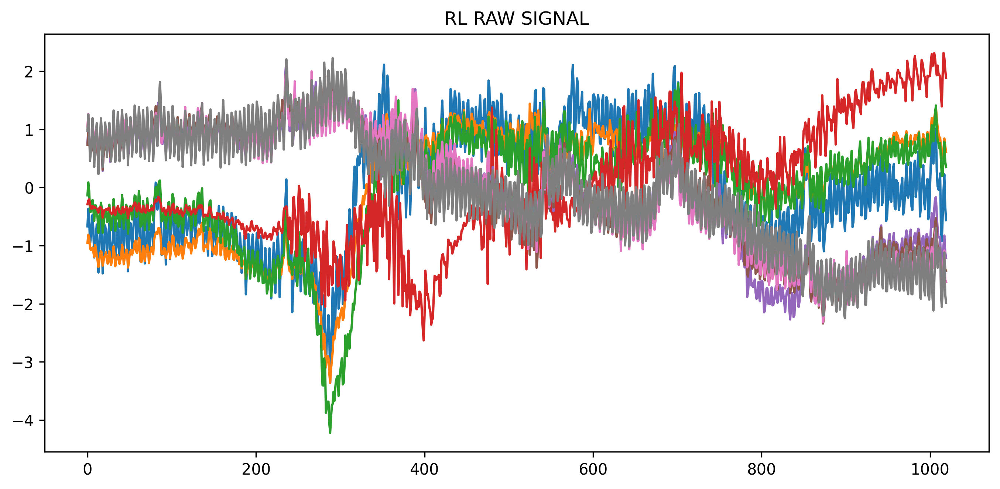

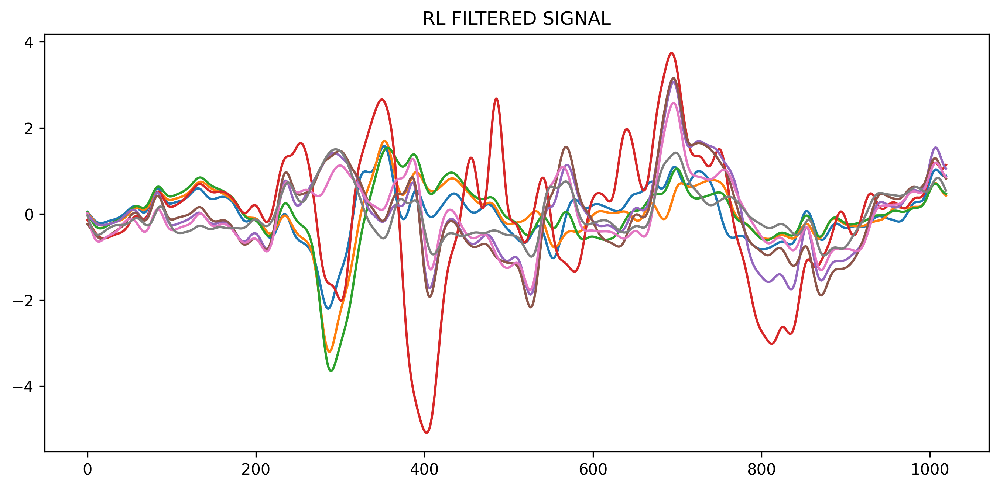

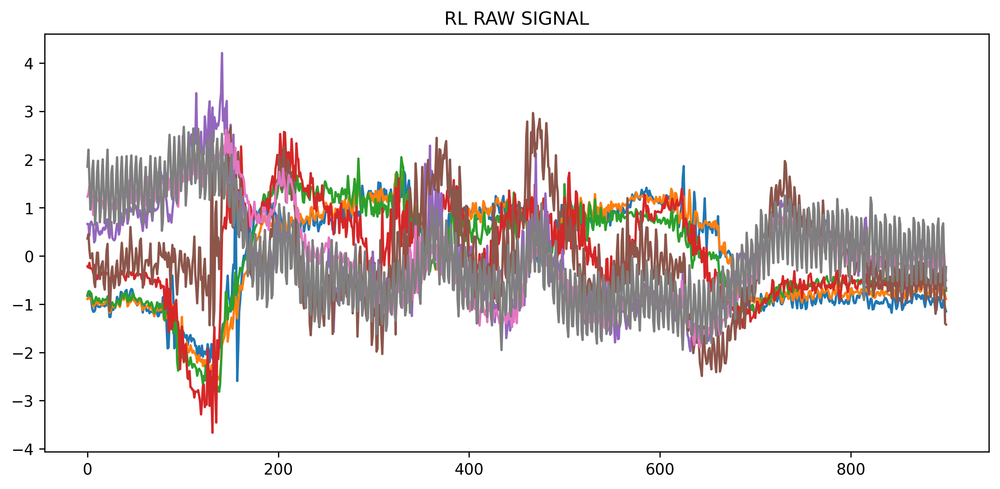

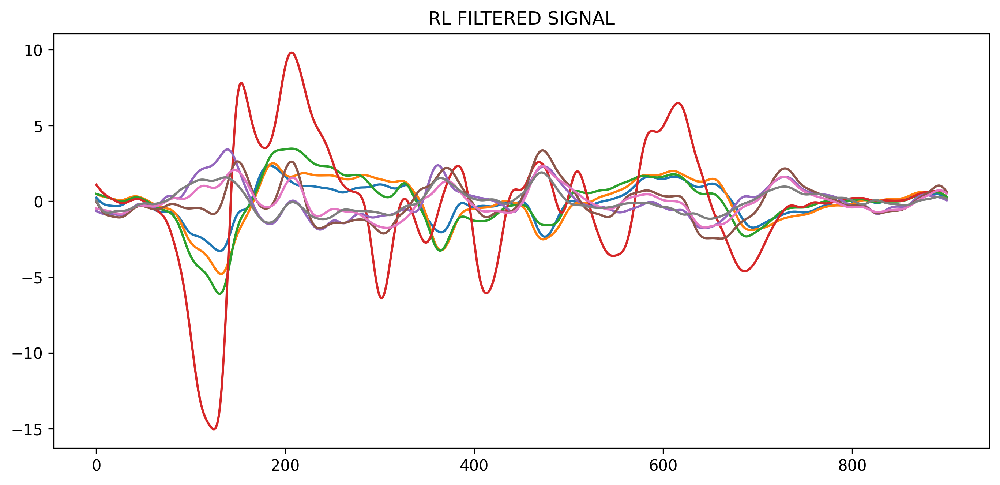

In [36]:
f_signals = preprocess_data(sample_RL_audible)

plt.title("RL RAW SIGNAL")
plt.plot(zscore(sample_RL_audible,axis=0))
plt.show()

plt.title("RL FILTERED SIGNAL")
plt.plot(f_signals)
plt.show()


f_signals = preprocess_data(sample_US_audible)

plt.title("RL RAW SIGNAL")
plt.plot(zscore(sample_US_audible,axis=0))
plt.show()

plt.title("RL FILTERED SIGNAL")
plt.plot(f_signals)
plt.show()

### TIME SERIES PLOT - MOUTHED

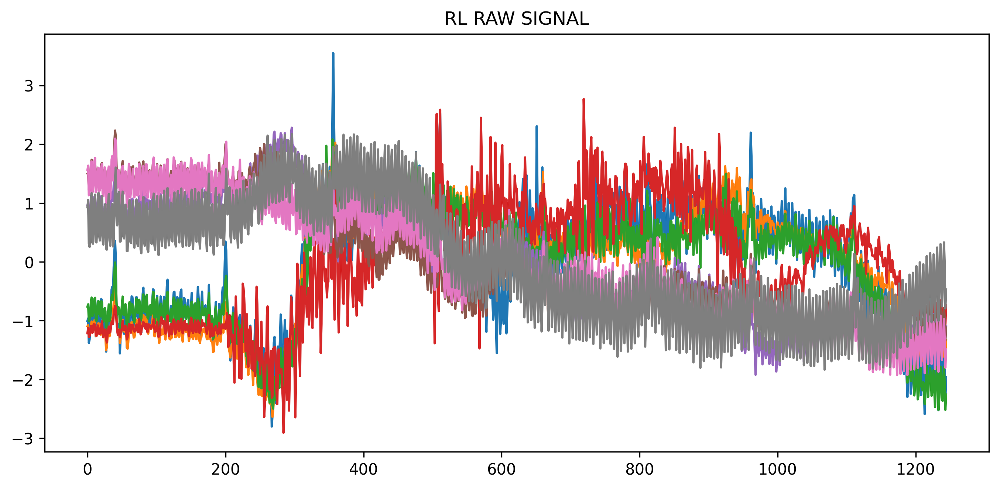

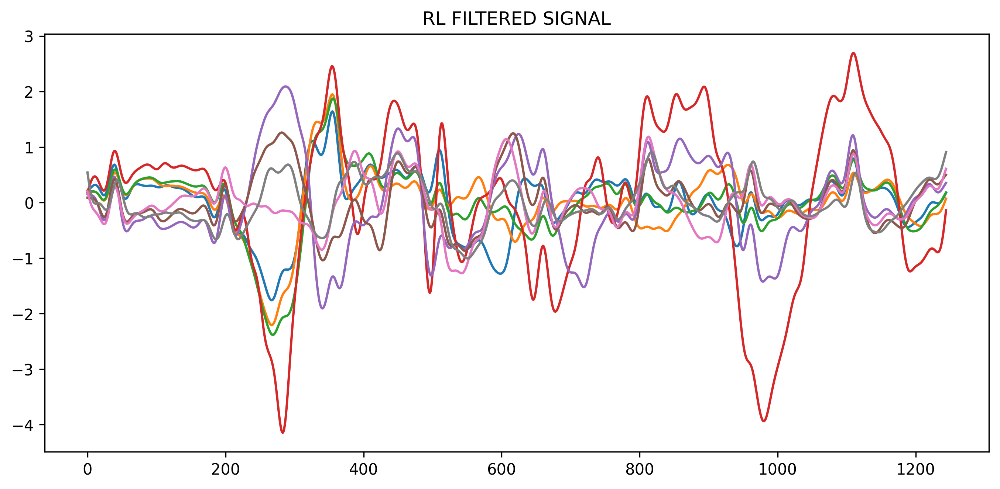

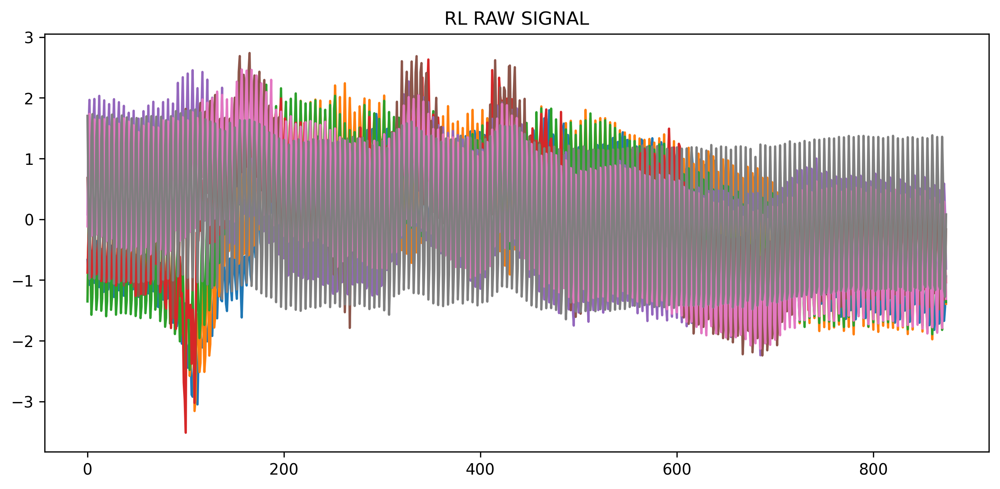

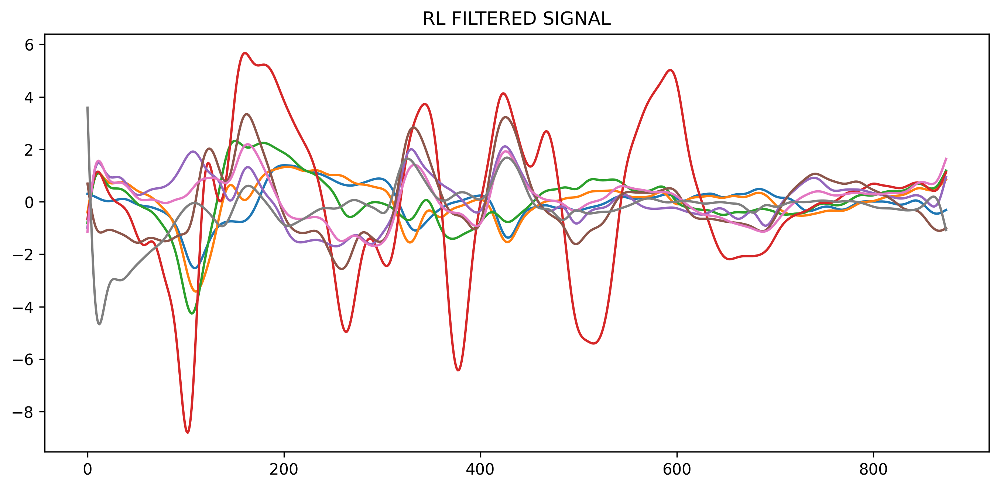

In [37]:
f_signals = preprocess_data(sample_RL_mouthed)

plt.title("RL RAW SIGNAL")
plt.plot(zscore(sample_RL_mouthed,axis=0))
plt.show()

plt.title("RL FILTERED SIGNAL")
plt.plot(f_signals)
plt.show()


f_signals = preprocess_data(sample_US_mouthed)

plt.title("RL RAW SIGNAL")
plt.plot(zscore(sample_US_mouthed,axis=0))
plt.show()

plt.title("RL FILTERED SIGNAL")
plt.plot(f_signals)
plt.show()

### TIME SERIES PLOT - MENTALLY

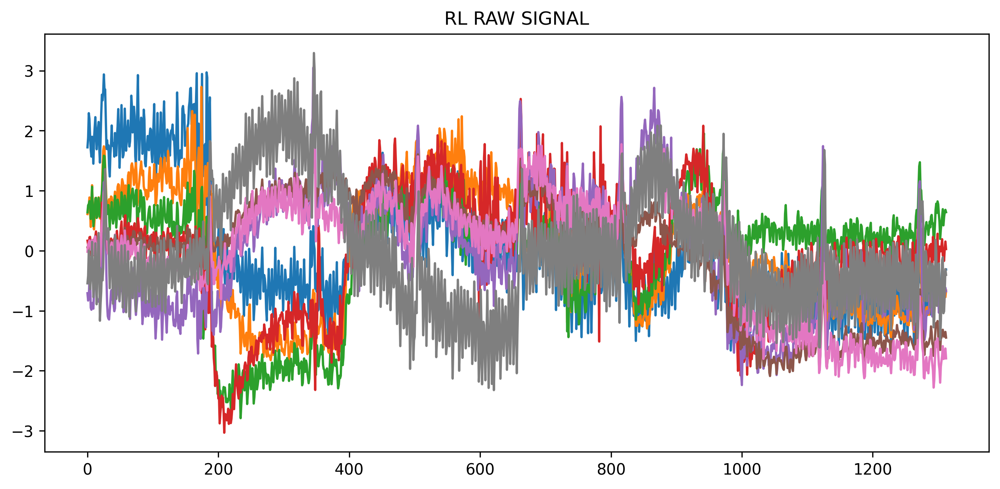

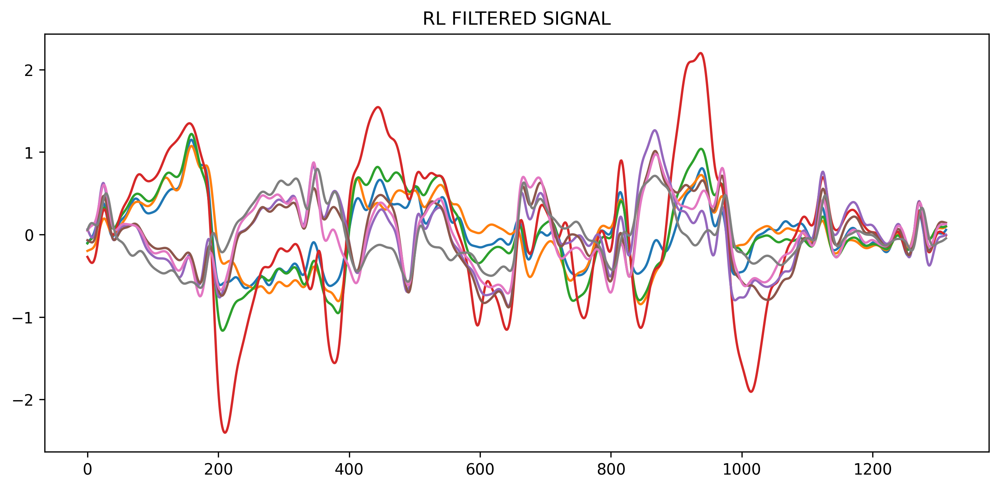

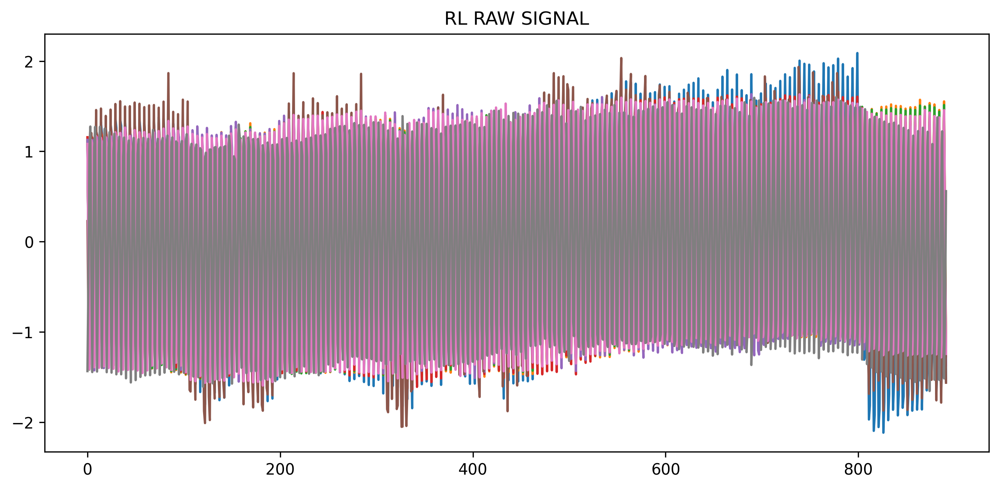

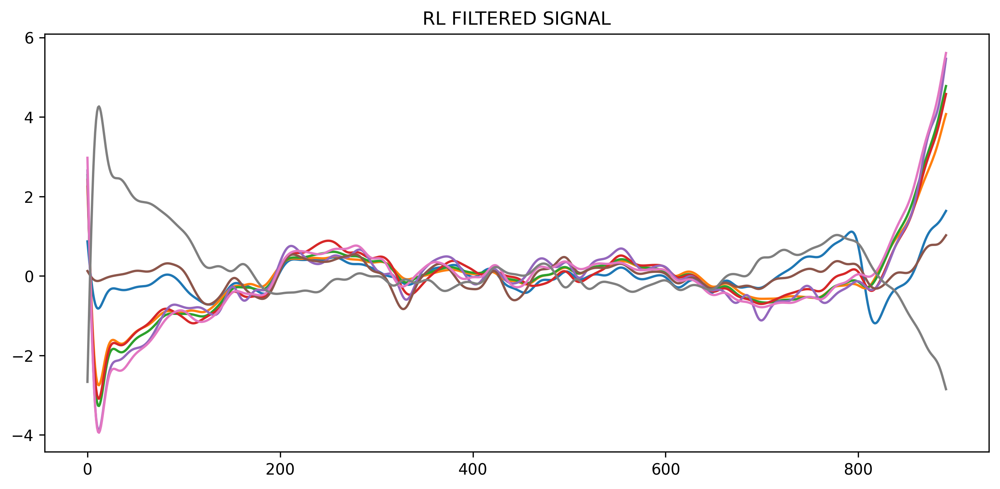

In [38]:
f_signals = preprocess_data(sample_RL_mentally)

plt.title("RL RAW SIGNAL")
plt.plot(zscore(sample_RL_mentally,axis=0))
plt.show()

plt.title("RL FILTERED SIGNAL")
plt.plot(f_signals)
plt.show()


f_signals = preprocess_data(sample_US_mentally)

plt.title("RL RAW SIGNAL")
plt.plot(zscore(sample_US_mentally,axis=0))
plt.show()

plt.title("RL FILTERED SIGNAL")
plt.plot(f_signals)
plt.show()

### FFT

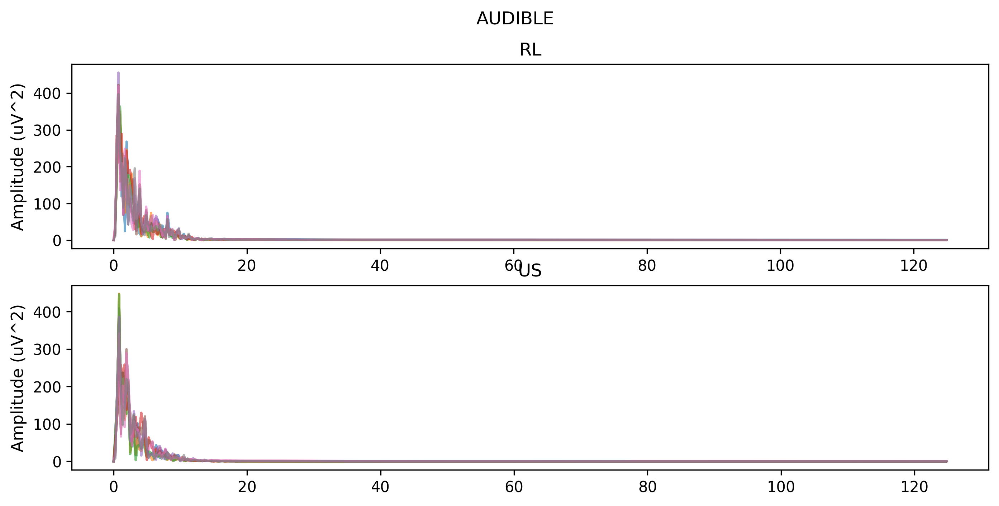

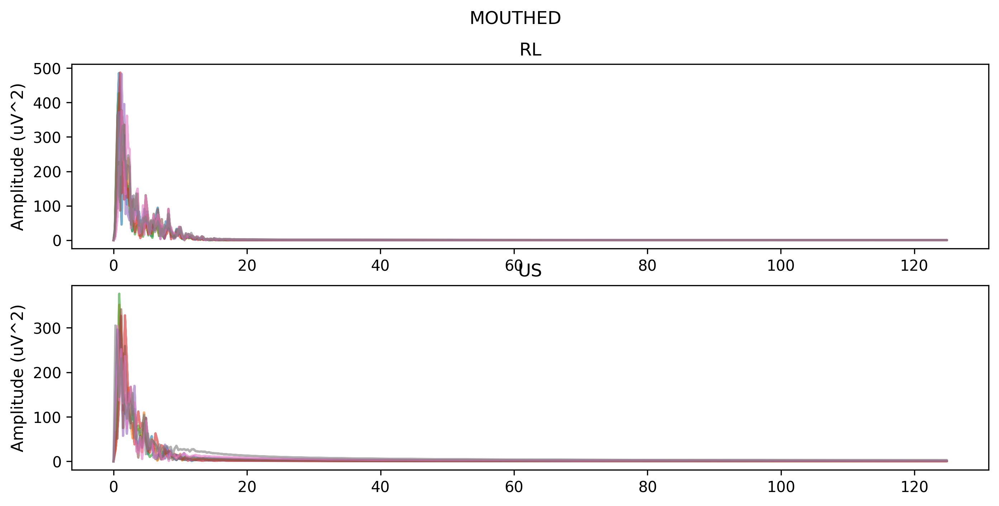

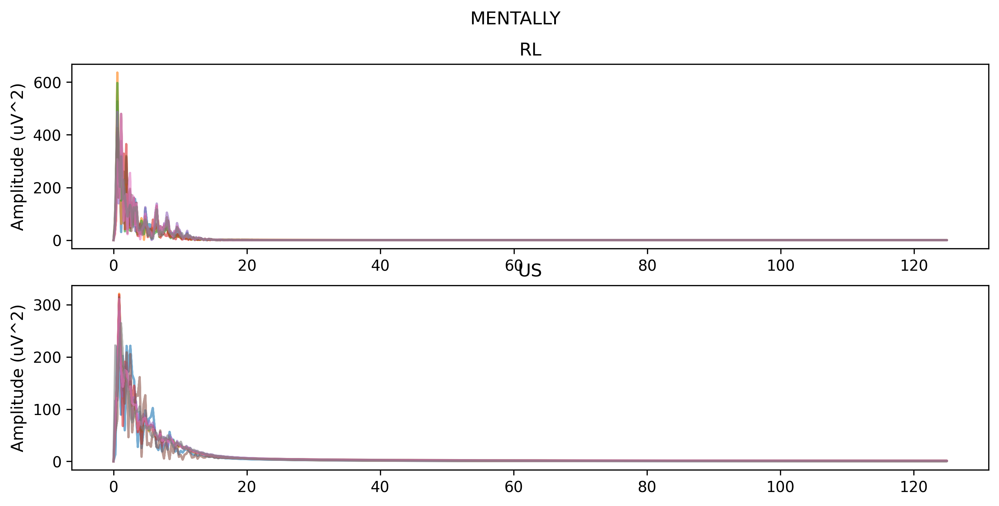

In [39]:

FFT(data1=preprocess_data(sample_RL_audible),data2=preprocess_data(sample_US_audible),MODE="AUDIBLE")
FFT(data1=preprocess_data(sample_RL_mouthed),data2=preprocess_data(sample_US_mouthed),MODE="MOUTHED")
FFT(data1=preprocess_data(sample_RL_mentally),data2=preprocess_data(sample_US_mentally),MODE="MENTALLY")

### POWER SPECTRUM

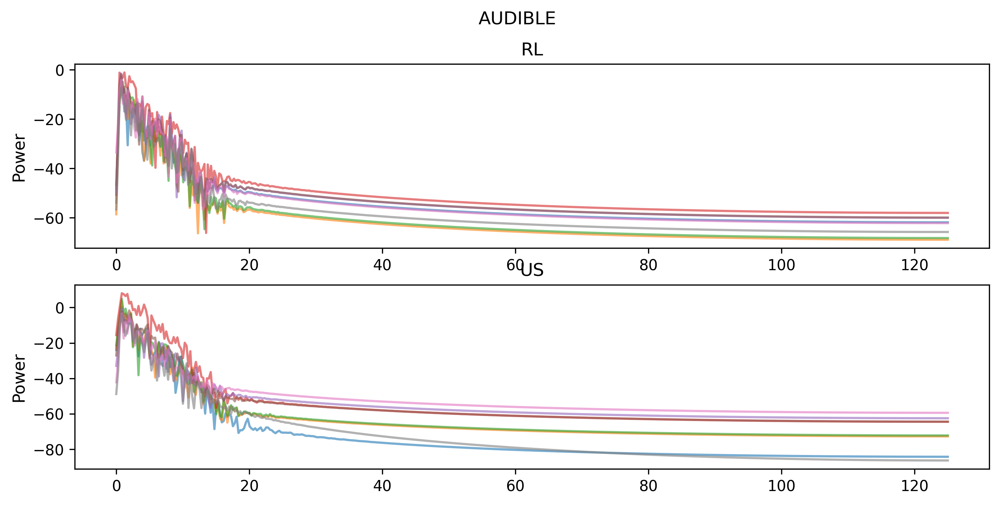

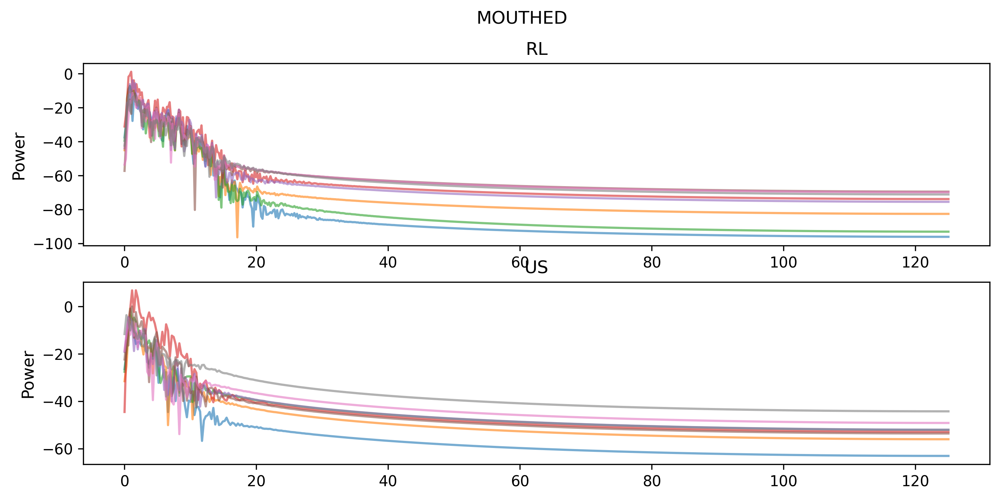

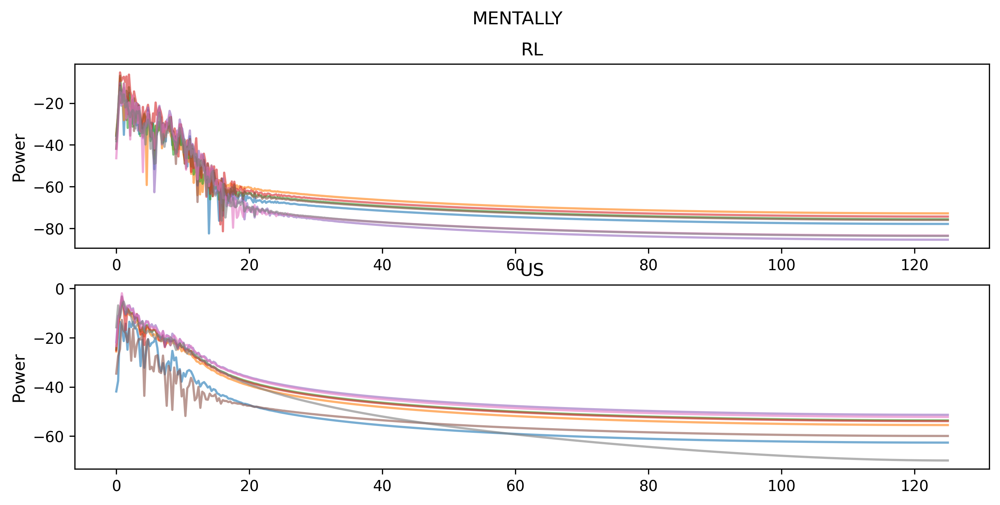

In [40]:
power_spec(data1=preprocess_data(sample_RL_audible),data2=preprocess_data(sample_US_audible),MODE="AUDIBLE")
power_spec(data1=preprocess_data(sample_RL_mouthed),data2=preprocess_data(sample_US_mouthed),MODE="MOUTHED")
power_spec(data1=preprocess_data(sample_RL_mentally),data2=preprocess_data(sample_US_mentally),MODE="MENTALLY")

### STFT

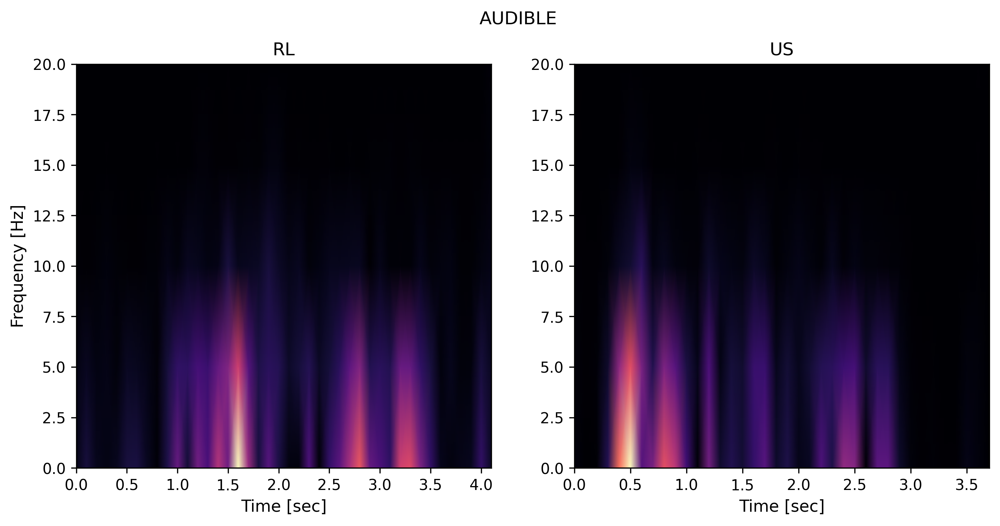

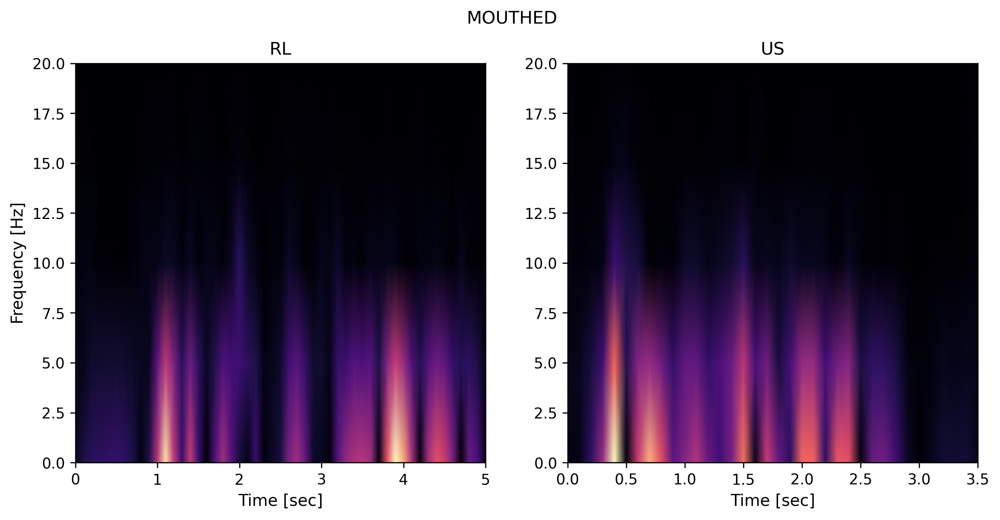

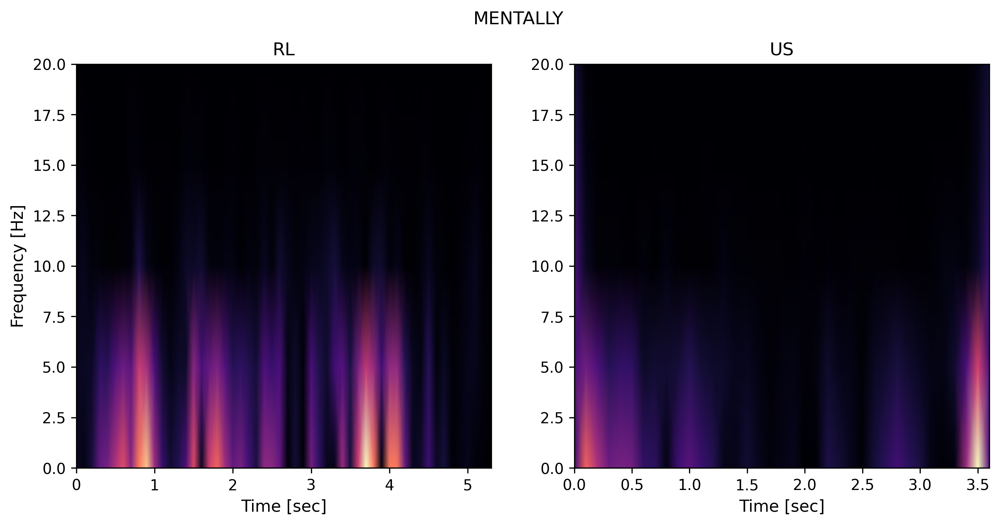

In [41]:
STFT(data1=preprocess_data(sample_RL_audible),data2=preprocess_data(sample_US_audible),MODE="AUDIBLE")
STFT(data1=preprocess_data(sample_RL_mouthed),data2=preprocess_data(sample_US_mouthed),MODE="MOUTHED")
STFT(data1=preprocess_data(sample_RL_mentally),data2=preprocess_data(sample_US_mentally),MODE="MENTALLY")


### SPECTOGRAM

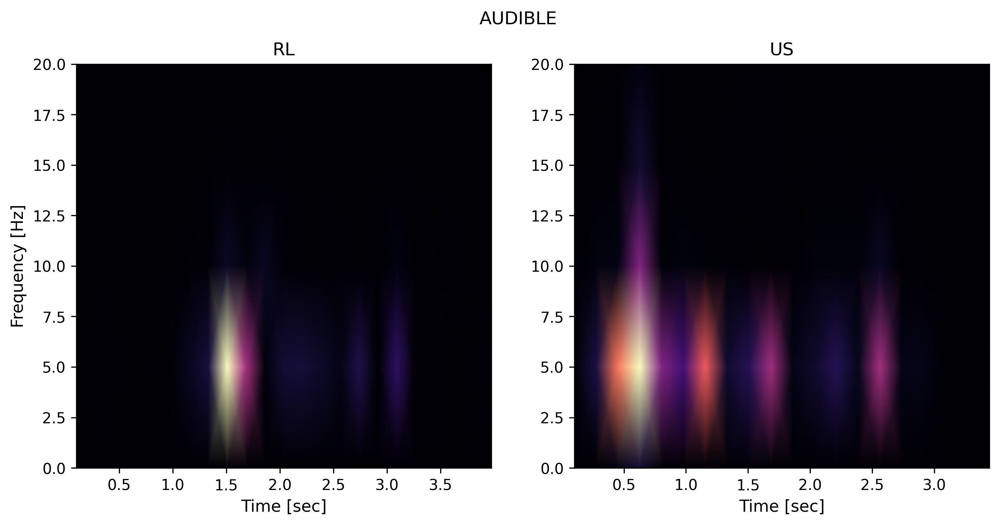

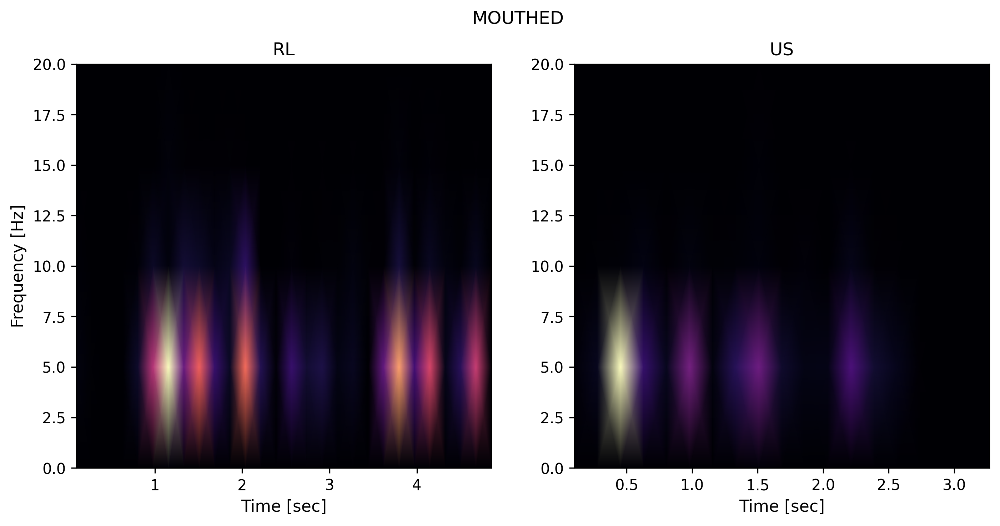

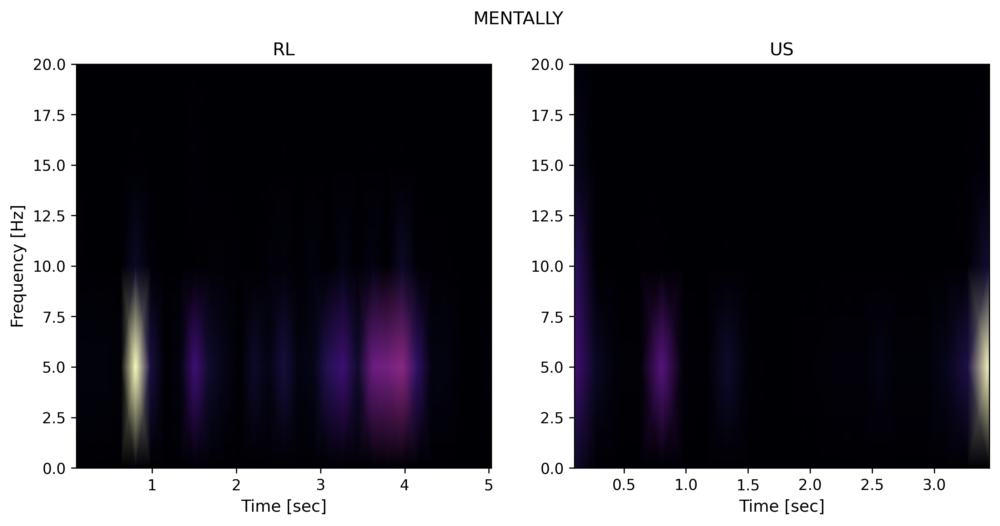

In [42]:
SPECTOGRAM(data1=preprocess_data(sample_RL_audible),data2=preprocess_data(sample_US_audible),MODE="AUDIBLE")
SPECTOGRAM(data1=preprocess_data(sample_RL_mouthed),data2=preprocess_data(sample_US_mouthed),MODE="MOUTHED")
SPECTOGRAM(data1=preprocess_data(sample_RL_mentally),data2=preprocess_data(sample_US_mentally),MODE="MENTALLY")

### MODE ANALYSIS (RIDERMAN KO SIGNAL)

In [43]:
def read_data(file):
    f = open(file, 'r')
    contents = map(lambda x : x.strip(), f.readlines())
    #the file starts with '%' and some instruction before data and removing these data 
    frames_original = list(filter(lambda x : x and x[0] != '%', contents))[1:]
    #the data row contains channels info digital trigger and accelerometer info separated by comma
    frames_original = list(map(lambda s : list(map( lambda ss: ss.strip(), s.split(','))), frames_original))
    # (8 channels) + digital triggers
    # the digital trigger is in a[16], used to indicate the utterance
    frames = list(map(lambda a: list(map(float, a[1:9])) + [float(a[16])] , frames_original))
    frames = np.array(frames)
    indices = []
    signal = []
    
    for index,f in enumerate(frames[:,-1]):
        if(bool(f) ^ bool(frames[(index+1) if ((index+1)<len(frames)) else index,-1]) ):
            indices.append(index)
            if len(indices)>1 and len(indices)%2==0:
                temp = frames[indices[len(indices)-2]:indices[len(indices)-1],:-1]
                if len(temp)< 50:
                    continue
                signal.append(temp)   

    return np.array(signal)

In [44]:
# order : mentally, mouthed, audible
three_modes = read_data("all_modes_test.txt")

In [45]:
three_modes.shape

(3,)

In [46]:
sample_mental = three_modes[0]
sample_mouthed = three_modes[1]
sample_audible = three_modes[2]

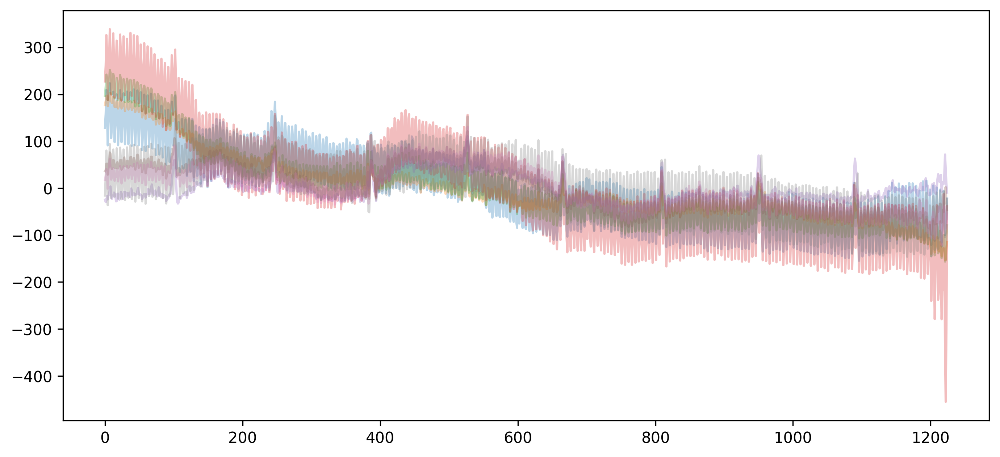

In [47]:
for i in range(NUM_CHANNELS):
    abc = sample_mouthed[:,i]-sample_mouthed[0,i]
    abc = abc - np.mean(abc)
    plt.plot(abc,alpha=0.3)
plt.show()

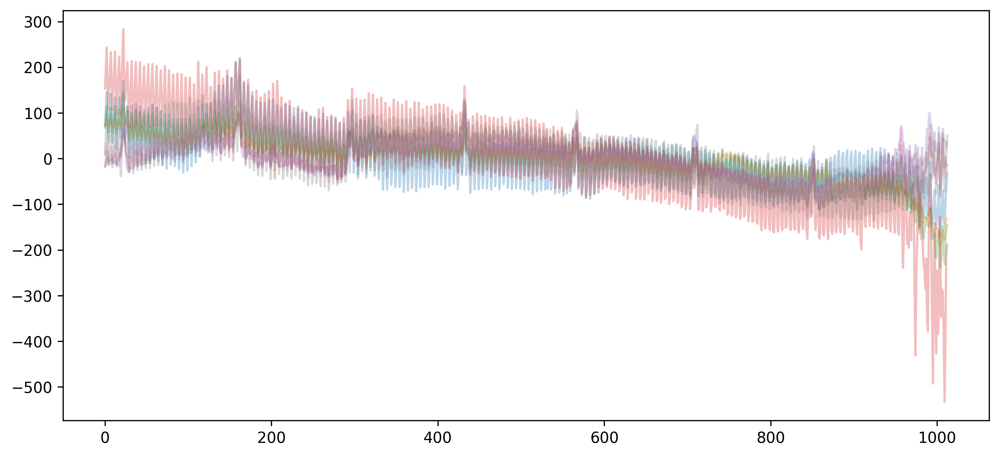

In [48]:
for i in range(NUM_CHANNELS):
    abc = sample_audible[:,i]-sample_audible[0,i]
    abc = abc - np.mean(abc)
    plt.plot(abc,alpha=0.3)
plt.show()

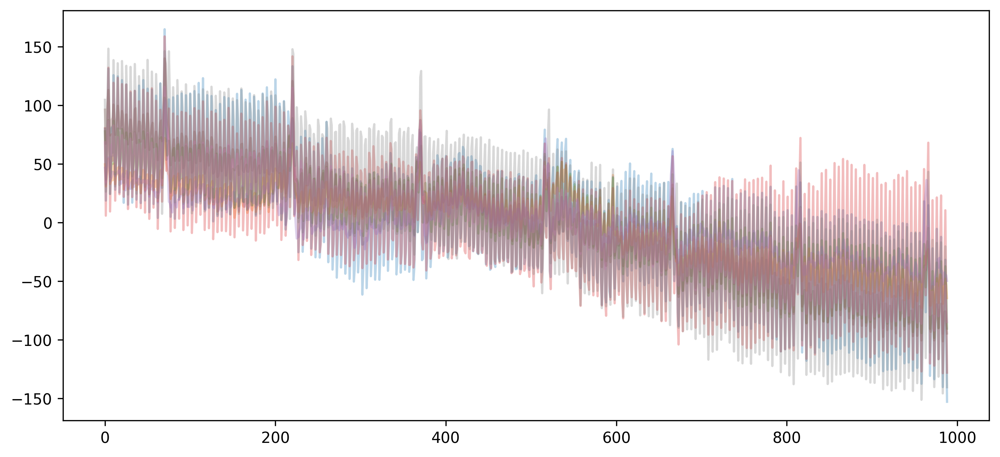

In [49]:
for i in range(NUM_CHANNELS):
    abc = sample_mental[:,i]-sample_mental[0,i]
    abc = abc - np.mean(abc)
    plt.plot(abc,alpha=0.3)
plt.show()

### CHANNEL ANALYSIS

In [50]:
# TODO : STD of all individual channels for filtered signal (not normalized) and see variation in signal content

df_data = pd.DataFrame(all_data["data"][0],
                       columns=["Channel 1","Channel 2","Channel 3","Channel 4",
                                "Channel 5","Channel 6","Channel 7","Channel 8"])

In [51]:
df_data.head(10)

,Channel 1,Channel 2,Channel 3,Channel 4,Channel 5,Channel 6,Channel 7,Channel 8
0,-530.978350,155.742448,41.755607,56.557772,-264.858698,-1434.850066,34.347532,661.722303
1,-532.703974,151.834079,37.505008,52.309669,-269.542437,-1435.151815,29.549868,668.109707
2,-530.833980,155.899827,42.414580,57.205252,-264.429541,-1433.525551,35.536081,667.825945
3,-527.993257,161.935998,49.454452,64.354034,-256.545836,-1432.682296,44.036284,660.226002
4,-528.516340,160.496144,47.696358,62.614429,-257.964691,-1434.072645,41.982925,656.229711
5,-530.867944,154.999547,41.221534,56.031190,-265.040547,-1435.012902,34.042277,661.427540
6,-532.467185,151.449385,37.256705,52.348637,-269.612395,-1435.121343,29.441954,667.851920
7,-530.389346,155.765433,42.409584,57.480032,-264.347097,-1433.379741,35.759902,667.618100
8,-527.741974,161.837074,49.396995,64.305074,-256.289053,-1432.876128,43.922875,660.054654
9,-528.496870,160.467670,47.575955,62.393105,-257.976195,-1434.523783,41.534785,656.077309


In [52]:
df_data.tail(10)

,Channel 1,Channel 2,Channel 3,Channel 4,Channel 5,Channel 6,Channel 7,Channel 8
494,-529.321177,158.146526,45.192360,58.771500,-260.103998,-1434.831032,40.609524,660.518278
495,-531.690812,152.811794,39.011802,52.583947,-266.907048,-1435.491020,33.165476,666.881671
496,-532.587588,151.032222,37.050870,50.597037,-269.374078,-1435.202718,30.773389,672.259404
497,-530.061623,156.810093,43.802470,57.261208,-262.490592,-1433.685942,38.704548,669.167835
498,-527.726476,161.877543,49.584349,63.114025,-256.063222,-1433.316265,45.523096,661.344113
499,-529.191782,158.252948,45.260804,58.853436,-260.440213,-1434.796108,40.492616,660.536264
500,-531.511430,152.979661,39.162183,52.789784,-267.008460,-1435.283655,33.267895,667.045074
501,-532.478667,151.093165,37.147292,50.769401,-269.432533,-1434.986883,30.897792,672.389280
502,-529.827279,156.977458,44.030287,57.578454,-262.075906,-1433.225287,39.162682,669.420165
503,-527.599089,161.931502,49.630308,63.176474,-255.686516,-1433.053458,45.648993,661.554927


In [53]:
df_data.describe()

,Channel 1,Channel 2,Channel 3,Channel 4,Channel 5,Channel 6,Channel 7,Channel 8
count,504.000000,504.000000,504.000000,504.000000,504.000000,504.000000,504.000000,504.000000
mean,-530.844454,156.224017,42.840729,57.101713,-263.102366,-1434.588300,37.045424,664.135940
std,1.823939,3.869028,4.478688,4.478628,4.811607,0.966129,5.269966,4.712148
min,-534.217781,150.296306,36.101129,49.719240,-270.833905,-1436.521732,28.777486,655.284957
25%,-532.491906,152.992398,39.075626,52.775170,-267.002092,-1435.347153,32.990368,660.036656
50%,-530.887437,155.891085,42.577201,56.922979,-263.546734,-1434.828282,36.608474,663.795406
75%,-529.169059,159.655572,46.551647,61.130990,-258.654392,-1433.730078,41.104128,668.138182
max,-527.566085,162.071888,49.630308,64.443463,-255.239372,-1432.519373,45.876312,672.447735
